### Run differential analysis across T cells from four datasets

In [1]:
import anndata as ad
import matplotlib.pyplot as plt
import muon as mu
import pandas as pd
import scanpy as sc
import numpy as np
import scirpy as ir
import matplotlib as mpl
import matplotlib.ticker as ticker
mpl.rcParams['font.family'] = 'Arial'
figPath = "figure-1.23"
plt.rcParams["font.sans-serif"] = ["Arial"]
plt.rcParams["axes.unicode_minus"] = False
plt.rcParams["font.size"] = 14

/home/rzh/BCY/lib/python3.10/site-packages/setuptools_scm/_integration/setuptools.py:30: RuntimeWarning: 
ERROR: setuptools==59.6.0 is used in combination with setuptools_scm>=8.x

Your build configuration is incomplete and previously worked by accident!
setuptools_scm requires setuptools>=61

Suggested workaround if applicable:
 - migrating from the deprecated setup_requires mechanism to pep517/518
   and using a pyproject.toml to declare build dependencies
   which are reliably pre-installed before running the build tools

  warnings.warn(


In [ ]:
def clu(adata, key_added="majorType-fix", 
        n_neighbors=50, n_pcs=30, 
        rep='X_pca_harmony', 
        do_har=False, 
        max_iter=20, 
        do_scrublet=False, 
        har_key='batch', 
        resolution=1):
    # Computing the neighborhood graph
    if do_scrublet:
        n0 = adata.shape[0]
        print("{0} Cell number: {1}".format(key_added, n0))
        sc.external.pp.scrublet(adata)
        adata = adata[adata.obs['predicted_doublet']==False,:].copy()
        print("{0} Cells retained after scrublet, {1} cells reomved.".format(adata.shape[0], n0-adata.shape[0]))
    else:
        print("Ignoring processing doublet cells...")
    sc.pp.highly_variable_genes(adata, n_top_genes=2000)
    sc.pp.pca(adata, svd_solver='arpack', use_highly_variable=True)
    if do_har and len(adata.obs[har_key].cat.categories) > 1:
        sc.external.pp.harmony_integrate(adata, key=har_key,max_iter_harmony=max_iter)
        sc.pp.neighbors(adata, n_neighbors=n_neighbors, n_pcs=n_pcs, use_rep=rep)
    else:
        print("Evaluating neighbors only...")
        sc.pp.neighbors(adata, n_neighbors=n_neighbors, n_pcs=n_pcs, use_rep=rep)
    # Run UMAP
    sc.tl.umap(adata)
    sc.tl.leiden(adata, resolution=resolution, key_added=key_added)
    sc.pl.umap(adata, color=key_added, legend_fontoutline=True, palette=sc.pl.palettes.default_20, legend_loc="on data")
    return adata

def anno(adata:ad.AnnData, annoDict:dict, obsKey='cnv_status', obsVal='cnv_leiden', default="Unknown"):
  if default is not None:
    adata.obs[obsKey] = default
  for key in annoDict.keys():
    adata.obs.loc[adata.obs[obsVal].isin(annoDict[key]), obsKey] = key
  return adata

Load and prepare all CD4T, CD8T cells from four datasets

In [3]:
# T cells YBC from native
adata_YBC_native_CD8 = sc.read_h5ad("adata-CD8T-3.3.h5ad")
adata_YBC_native_CD4 = sc.read_h5ad("adata-CD4T-3.3.h5ad")

In [ ]:
# T cells OBC from native
adata_OBC_native_CD8 = sc.read_h5ad("adata-OBC-native-CD8T-3.24.h5ad")
adata_OBC_native_CD4 = sc.read_h5ad("adata-OBC-native-CD4T-3.24.h5ad")

In [160]:
# T cells OBC from external
adata_OBC_exter_CD8 = sc.read_h5ad("adata-CD8T-old-1.26.h5ad")
adata_OBC_exter_CD4 = sc.read_h5ad("adata-CD4T-old-1.26.h5ad")

/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/anndata.py:1897: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/anndata.py:1897: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [113]:
# T cells YBC from external
adata_YBC_exter = sc.read_h5ad('adata-GSE161529.h5ad')
adata_YBC_exter

AnnData object with n_obs × n_vars = 33698 × 23936
    obs: 'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'doublet_score', 'predicted_doublet', 'leiden-major', 'major-type'
    var: 'ID', 'name', 'type', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'dea_leiden-major', 'dendrogram_leiden-major', 'hvg', 'leiden-major', 'leiden-major_colors', 'log1p', 'major-type_colors', 'neighbors', 'pca', 'scrublet', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


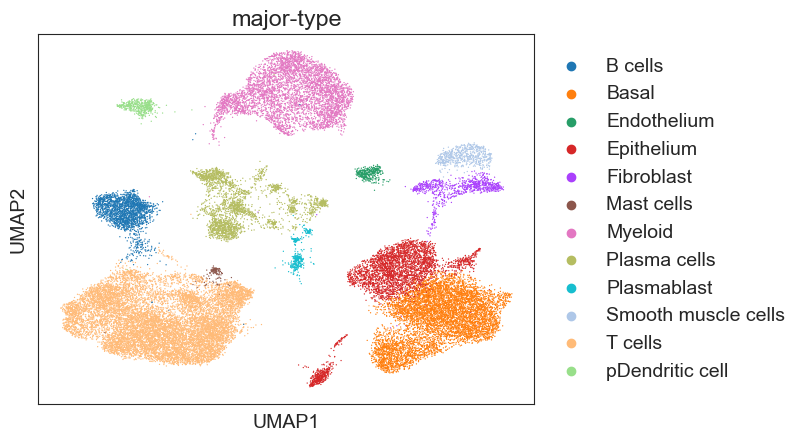

In [564]:
sc.pl.umap(adata_YBC_exter, color=['major-type'])

In [655]:
adata_Fib = adata_YBC_exter[adata_YBC_exter.obs['major-type'].isin(['Fibroblast', 'Smooth muscle cells'])]

In [656]:
adata_Fib.write_h5ad("adata-YBC-exter-Fib-4.21.h5ad")

Ignoring processing doublet cells...


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:544: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns['hvg'] = {'flavor': flavor}
2025-04-09 13:48:51,168 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-04-09 13:48:53,627 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-04-09 13:48:53,644 - harmonypy - INFO - Iteration 1 of 20
2025-04-09 13:48:54,388 - harmonypy - INFO - Iteration 2 of 20
2025-04-09 13:48:55,124 - harmonypy - INFO - Iteration 3 of 20
2025-04-09 13:48:55,864 - harmonypy - INFO - Iteration 4 of 20
2025-04-09 13:48:56,572 - harmonypy - INFO - Iteration 5 of 20
2025-04-09 13:48:57,132 - harmonypy - INFO - Iteration 6 of 20
2025-04-09 13:48:57,783 - harmonypy - INFO - Iteration 7 of 20
2025-04-09 13:48:58,141 - harmonypy - INFO - Iteration 8 of 20
2025-04-09 13:48:58,560 - harmonypy - INFO - Iteration 9 of 20
2025-04-09 13:4

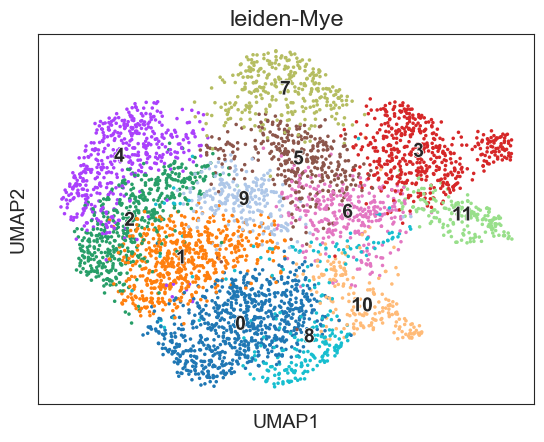

In [643]:
adata_YBC_exter_Mye = adata_YBC_exter[adata_YBC_exter.obs['major-type'] == 'Myeloid']
adata_YBC_exter_Mye = clu(adata_YBC_exter_Mye, key_added='leiden-Mye', do_har=True, n_pcs=20)

In [637]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler
import numpy as np
import pandas as pd
from scipy.spatial.distance import pdist, squareform
from scipy.cluster.hierarchy import linkage, dendrogram
import matplotlib.pyplot as plt
def get_batch_groups(adata, groupby, clusters, key_added):
    class AnomalyAwareDistance:
        def __init__(self, alpha=1.0, epsilon=1e-8):
            self.alpha = alpha
            self.epsilon = epsilon  # 数值稳定系数
            
        def _safe_zscore(self, X):
            """带数值稳定的Z-Score计算"""
            mean = np.nanmean(X, axis=0)
            std = np.nanstd(X, axis=0)
            std = np.where(std < self.epsilon, self.epsilon, std)
            return np.abs((X - mean) / std)
        
        def _robust_weights(self, X):
            """带异常处理的权重计算"""
            z_scores = self._safe_zscore(X)
            weights = np.power(z_scores, self.alpha)
            
            # 处理全零权重列
            max_weights = np.max(weights, axis=0)
            max_weights = np.where(max_weights == 0, 1, max_weights)
            return weights / max_weights
        
        def __call__(self, u, v):
            X = np.vstack([u, v])
            weights = self._robust_weights(X)
            final_weights = np.max(weights, axis=0)
            return np.sqrt(np.nansum(final_weights * (u - v)**2))

    barlabels = adata.obs[groupby].cat.categories
    cell_types = adata.obs[clusters].cat.categories
    age_df = pd.DataFrame(columns = list(cell_types))
    for bar in barlabels:
        d1 = pd.DataFrame([len(adata[(adata.obs[clusters] == ct) & (adata.obs[groupby] == bar)]) for ct in list(cell_types)], index = list(cell_types), columns=[bar]).T
        age_df = pd.concat([age_df, d1])
    all_df = age_df.sum(axis=1)
    age_normdf = pd.DataFrame([age_df.loc[i,:]/all_df[i] for i in barlabels], index=barlabels)
    scaler = StandardScaler()
    age_scaledf = scaler.fit_transform(age_normdf)
    age_scaledf = pd.DataFrame(age_scaledf, columns=age_normdf.columns, index = age_normdf.index)
    age_scaledf = age_scaledf.T
    # 创建自定义距离计算器
    custom_dist = AnomalyAwareDistance(alpha=2.0)

    # 计算距离矩阵
    distance_matrix = pdist(age_scaledf.T, metric=custom_dist)

    # 执行层次聚类
    Z = linkage(distance_matrix, method='ward')

    # 可视化树状图
    plt.figure(figsize=(10, 6))
    dendrogram(Z, 
            labels=age_scaledf.columns.tolist(),
            leaf_font_size=12)
    plt.show()

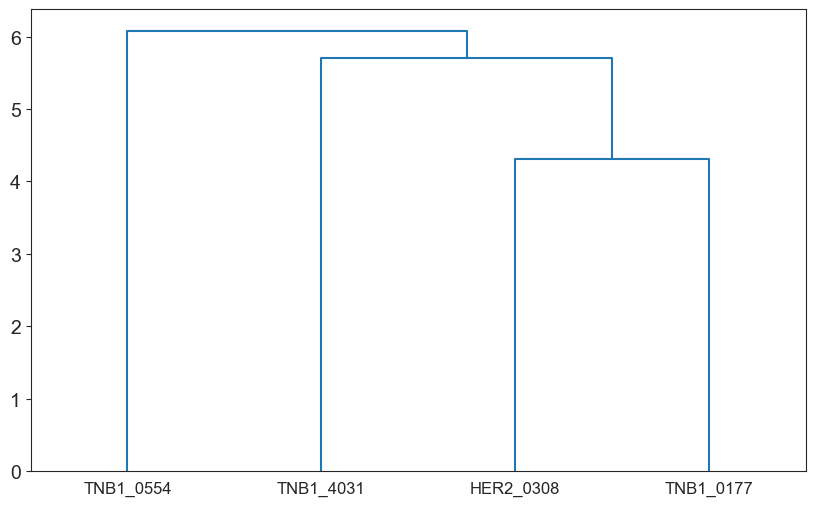

In [ ]:
get_batch_groups(adata_YBC_exter_Mye, groupby='batch', clusters='leiden-Mye', key_added='groups')

In [644]:
sc.tl.leiden(adata_YBC_exter_Mye, resolution=1.5, key_added='leiden-Mye1.5')
sc.tl.leiden(adata_YBC_exter_Mye, resolution=1.8, key_added='leiden-Mye1.8')
sc.tl.leiden(adata_YBC_exter_Mye, resolution=2.0, key_added='leiden-Mye2.0')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


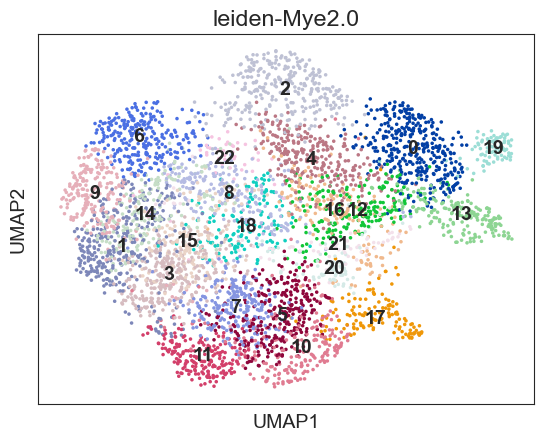

In [645]:
sc.pl.umap(adata_YBC_exter_Mye, color=['leiden-Mye2.0'], legend_loc='on data')

In [650]:
adata_YBC_exter_Mye.write_h5ad("adata-YBC-exter-Mye-4.9.h5ad")

In [ ]:
annot = {
  "Mac1_SPP1": ['0', '1', '6', '8', '10', '17', '19', '20'],
  
  "Mac3_FOLR2": ['18'],
}
adata_YBC_exter_Mye = anno(adata_YBC_exter_Mye, )

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:398: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:401: PerformanceWarning: DataFrame is highly fragmented.  This is usually t

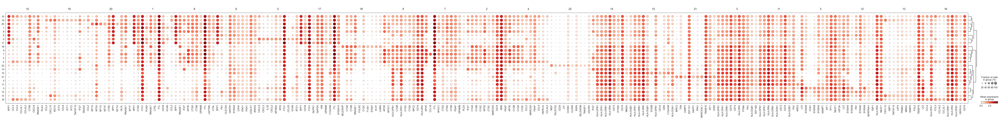

In [622]:
sc.tl.rank_genes_groups(adata_YBC_exter_Mye, groupby='leiden-Mye2.0')
sc.tl.dendrogram(adata_YBC_exter_Mye, groupby='leiden-Mye2.0')
sc.pl.rank_genes_groups_dotplot(adata_YBC_exter_Mye)

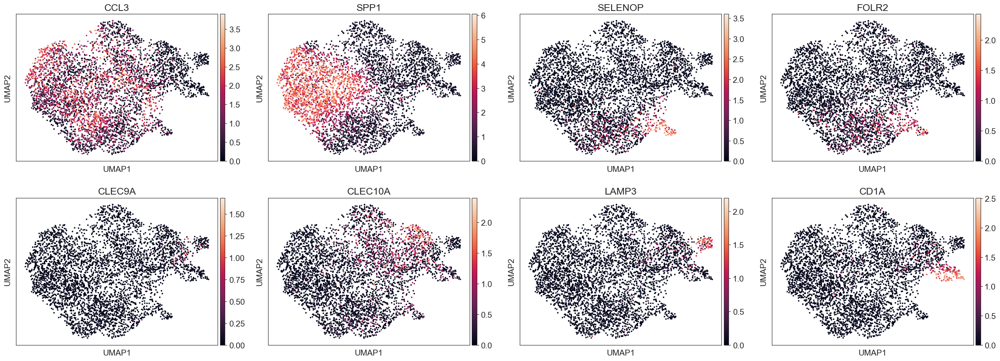

In [649]:
sc.pl.umap(adata_YBC_exter_Mye, color=['CCL3', 'SPP1', 'SELENOP', 'FOLR2', 'CLEC9A', 'CLEC10A', 'LAMP3', 'CD1A'])

In [ ]:
adata_YBC_exter_T = adata_YBC_exter[adata_YBC_exter.obs['major-type'] == 'T cells']

Ignoring processing doublet cells...


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:544: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns['hvg'] = {'flavor': flavor}
2025-03-25 06:32:50,493 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-03-25 06:33:05,013 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-03-25 06:33:05,254 - harmonypy - INFO - Iteration 1 of 20
2025-03-25 06:33:08,361 - harmonypy - INFO - Iteration 2 of 20
2025-03-25 06:33:11,420 - harmonypy - INFO - Iteration 3 of 20
2025-03-25 06:33:14,387 - harmonypy - INFO - Iteration 4 of 20
2025-03-25 06:33:17,644 - harmonypy - INFO - Iteration 5 of 20
2025-03-25 06:33:19,819 - harmonypy - INFO - Iteration 6 of 20
2025-03-25 06:33:22,465 - harmonypy - INFO - Iteration 7 of 20
2025-03-25 06:33:24,715 - harmonypy - INFO - Iteration 8 of 20
2025-03-25 06:33:25,822 - harmonypy - INFO - Iteration 9 of 20
2025-03-25 06:3

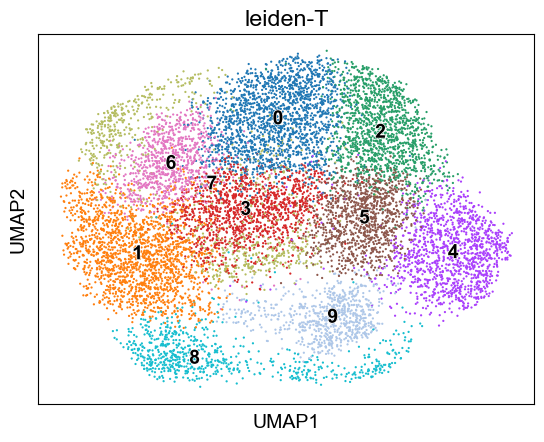

In [121]:
adata_YBC_exter_T = clu(adata_YBC_exter_T, key_added='leiden-T', do_har=True)

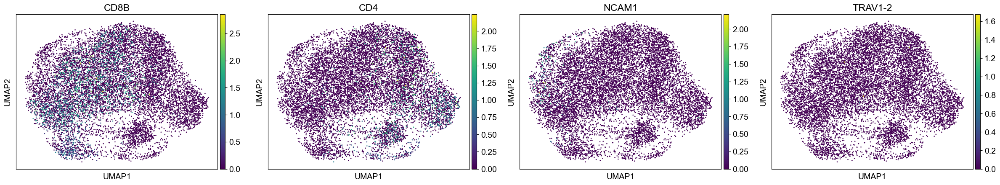

In [124]:
sc.pl.umap(adata_YBC_exter_T, color=['CD8B', 'CD4', 'NCAM1', "TRAV1-2"], size=15)

In [125]:
sc.tl.leiden(adata_YBC_exter_T, resolution=1.5, key_added='leiden-T1.5')
sc.tl.leiden(adata_YBC_exter_T, resolution=2, key_added='leiden-T2')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


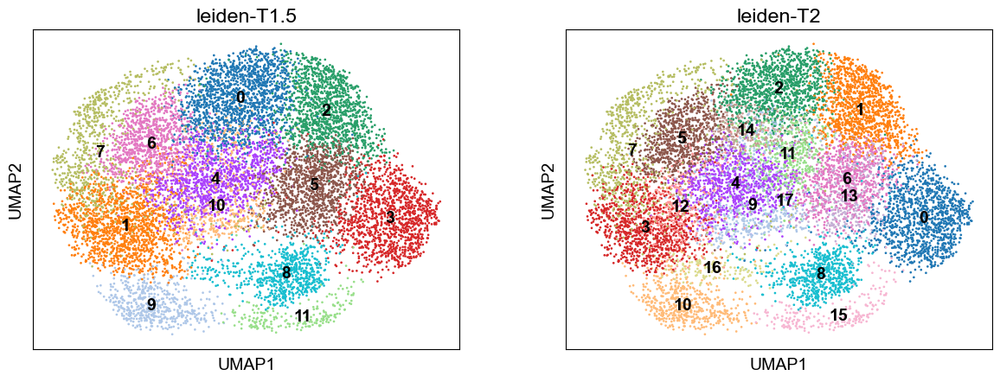

In [126]:
sc.pl.umap(adata_YBC_exter_T, color=['leiden-T1.5', 'leiden-T2'], size=15, legend_loc='on data')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


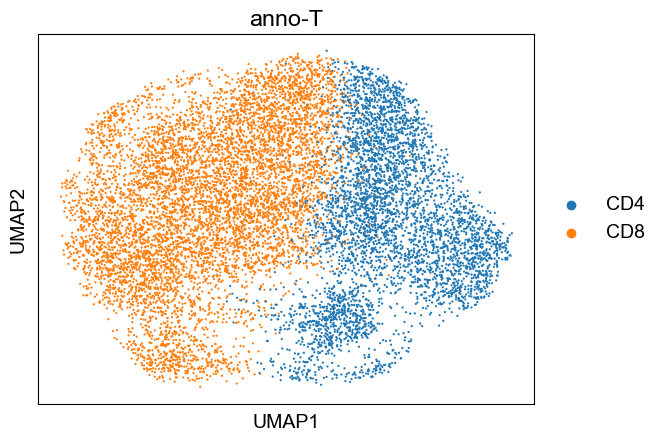

In [127]:
annot = {
  'CD4': ['0', '1', '6', '8', '13', '15'],
  'CD8': ['2','3','4','5', '7', '9', '10', '11', '14', '12', '17', '16']
}
adata_YBC_exter_T = anno(adata_YBC_exter_T, annot, obsKey='anno-T', obsVal='leiden-T2')
sc.pl.umap(adata_YBC_exter_T, color=['anno-T'])

In [ ]:
adata_YBC_exter_CD8 = adata_YBC_exter_T[adata_YBC_exter_T.obs['anno-T'] == 'CD8']
adata_YBC_exter_CD8.write_h5ad("adata-YBC-exter-CD8T-3.24.h5ad")
adata_YBC_exter_CD4 = adata_YBC_exter_T[adata_YBC_exter_T.obs['anno-T'] == 'CD4']
adata_YBC_exter_CD4.write_h5ad("adata-YBC-exter-CD4T-3.24.h5ad")

Ignoring processing doublet cells...


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:544: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns['hvg'] = {'flavor': flavor}
2025-03-25 06:59:53,494 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-03-25 06:59:57,738 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-03-25 06:59:57,806 - harmonypy - INFO - Iteration 1 of 20
2025-03-25 06:59:59,509 - harmonypy - INFO - Iteration 2 of 20
2025-03-25 07:00:01,235 - harmonypy - INFO - Iteration 3 of 20
2025-03-25 07:00:02,935 - harmonypy - INFO - Iteration 4 of 20
2025-03-25 07:00:04,261 - harmonypy - INFO - Iteration 5 of 20
2025-03-25 07:00:05,345 - harmonypy - INFO - Iteration 6 of 20
2025-03-25 07:00:06,285 - harmonypy - INFO - Iteration 7 of 20
2025-03-25 07:00:07,216 - harmonypy - INFO - Iteration 8 of 20
2025-03-25 07:00:08,296 - harmonypy - INFO - Iteration 9 of 20
2025-03-25 07:0

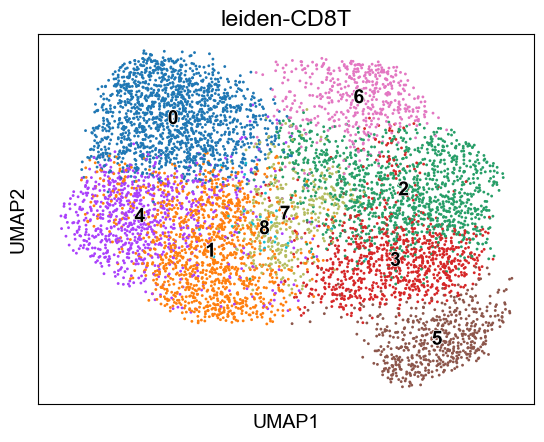

In [130]:
adata_YBC_exter_CD8 = clu(adata_YBC_exter_CD8, key_added='leiden-CD8T', do_har=True)

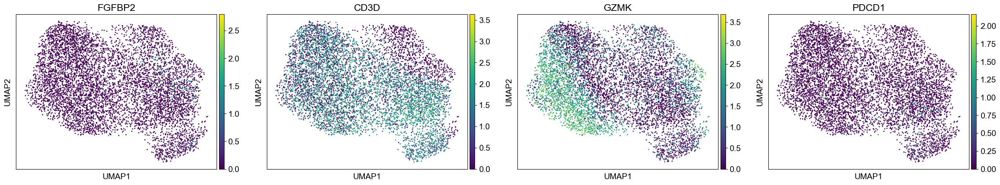

In [142]:
sc.pl.umap(adata_YBC_exter_CD8, color=['FGFBP2', 'CD3D', 'GZMK', 'PDCD1'])

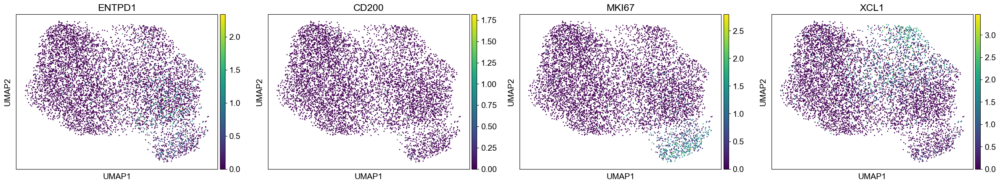

In [139]:
sc.pl.umap(adata_YBC_exter_CD8, color=['ENTPD1', 'CD200', 'MKI67', 'XCL1'], size=15)

In [135]:
sc.tl.leiden(adata_YBC_exter_CD8, resolution=1.5, key_added='leiden-CD8T1.5')
sc.tl.leiden(adata_YBC_exter_CD8, resolution=2, key_added='leiden-CD8T2')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


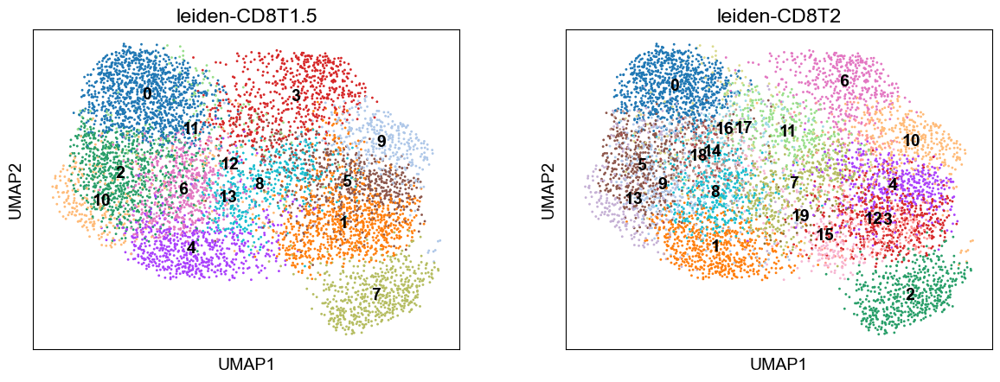

In [136]:
sc.pl.umap(adata_YBC_exter_CD8, color=['leiden-CD8T1.5', 'leiden-CD8T2'], legend_loc='on data')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


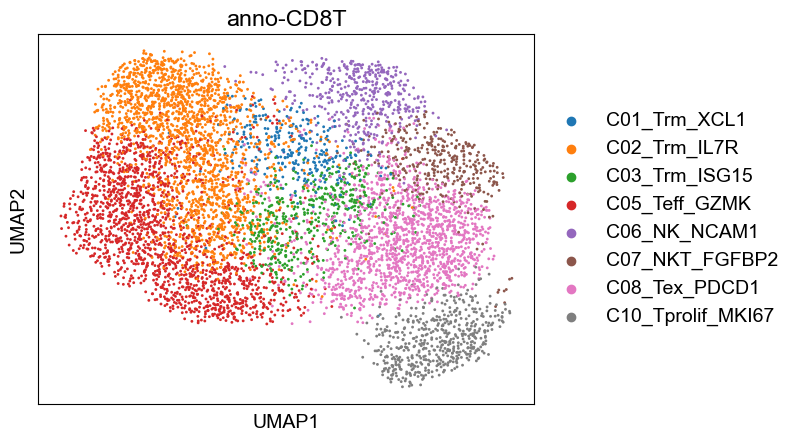

In [146]:
annot = {
  'C01_Trm_XCL1': ['11'],
  'C02_Trm_IL7R': ['0', '8', '14', '16', '17', '18'],
  'C03_Trm_ISG15': ['7', '19'],
  'C05_Teff_GZMK': ['1', '5', '9', '13'],
  'C06_NK_NCAM1': ['6'],
  'C07_NKT_FGFBP2': ['10'],
  'C08_Tex_PDCD1': ['3', '4', '12', '15'],
  'C10_Tprolif_MKI67': ['2'],
}
adata_YBC_exter_CD8 = anno(adata_YBC_exter_CD8, annot, obsKey='anno-CD8T', obsVal='leiden-CD8T2')
sc.pl.umap(adata_YBC_exter_CD8, color=['anno-CD8T'])

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


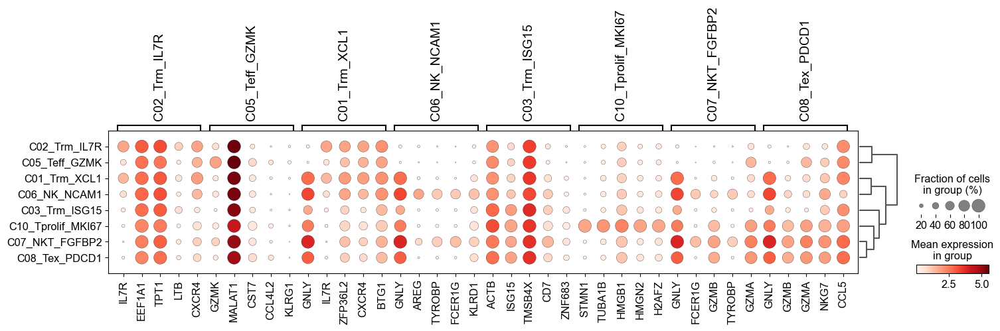

In [150]:
sc.tl.rank_genes_groups(adata_YBC_exter_CD8, groupby='anno-CD8T')
sc.tl.dendrogram(adata_YBC_exter_CD8, groupby='anno-CD8T')
sc.pl.rank_genes_groups_dotplot(adata_YBC_exter_CD8, groupby='anno-CD8T', n_genes=5)

In [148]:
adata_YBC_exter_CD8.write_h5ad("adata-YBC-exter-CD8T-3.24.h5ad")

Ignoring processing doublet cells...


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:544: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns['hvg'] = {'flavor': flavor}
2025-03-25 07:45:17,581 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-03-25 07:45:20,243 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-03-25 07:45:20,260 - harmonypy - INFO - Iteration 1 of 20
2025-03-25 07:45:21,313 - harmonypy - INFO - Iteration 2 of 20
2025-03-25 07:45:22,284 - harmonypy - INFO - Iteration 3 of 20
2025-03-25 07:45:23,168 - harmonypy - INFO - Iteration 4 of 20
2025-03-25 07:45:23,796 - harmonypy - INFO - Iteration 5 of 20
2025-03-25 07:45:24,257 - harmonypy - INFO - Iteration 6 of 20
2025-03-25 07:45:24,719 - harmonypy - INFO - Iteration 7 of 20
2025-03-25 07:45:25,111 - harmonypy - INFO - Iteration 8 of 20
2025-03-25 07:45:25,473 - harmonypy - INFO - Iteration 9 of 20
2025-03-25 07:4

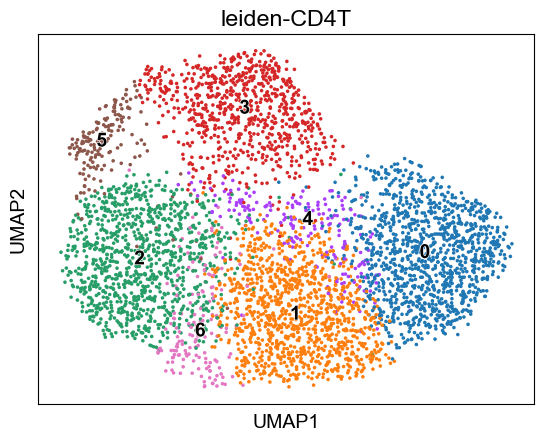

In [149]:
adata_YBC_exter_CD4 = clu(adata_YBC_exter_CD4, key_added='leiden-CD4T', do_har=True)

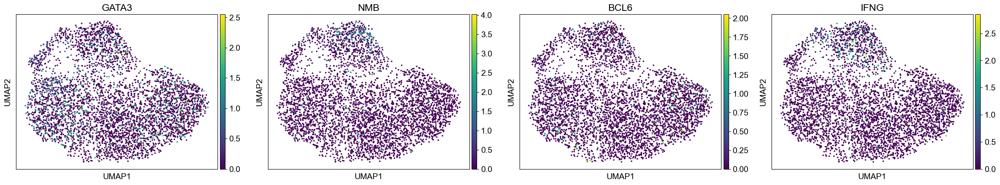

In [156]:
sc.pl.umap(adata_YBC_exter_CD4, color=['GATA3', 'NMB', 'BCL6', 'IFNG'])

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


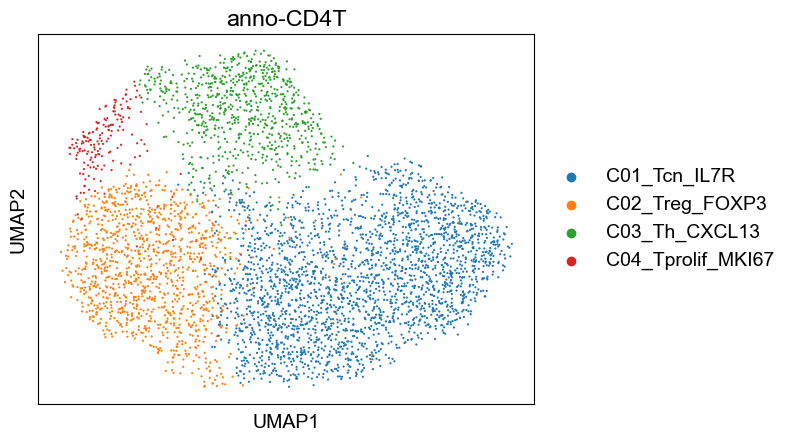

In [154]:
annot = {
  'C01_Tcn_IL7R': [ '0', '1', '4'],
  'C02_Treg_FOXP3': ['2', '6'],
  'C03_Th_CXCL13': ['3'],
  'C04_Tprolif_MKI67': ['5'],
}
adata_YBC_exter_CD4 = anno(adata_YBC_exter_CD4, annot, "anno-CD4T", 'leiden-CD4T')
sc.pl.umap(adata_YBC_exter_CD4, color=['anno-CD4T'], size=10)

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


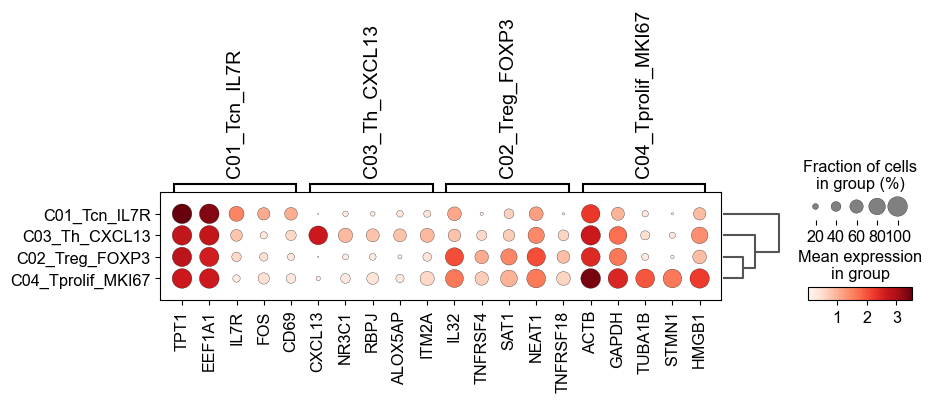

In [155]:
sc.tl.rank_genes_groups(adata_YBC_exter_CD4, groupby='anno-CD4T')
sc.tl.dendrogram(adata_YBC_exter_CD4, groupby='anno-CD4T')
sc.pl.rank_genes_groups_dotplot(adata_YBC_exter_CD4, groupby='anno-CD4T', n_genes=5)

In [157]:
adata_YBC_exter_CD4.write_h5ad("adata-YBC-exter-CD4T-3.24.h5ad")

In [ ]:
# T cells OBC from native
adata_OBC_native = sc.read_h5ad("bcm_T.h5ad")
adata_OBC_native.obs['batch'] = adata_OBC_native.obs['sample']

/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/anndata.py:1897: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Ignoring processing doublet cells...


2025-03-24 06:49:59,902 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-03-24 06:50:28,255 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-03-24 06:50:30,761 - harmonypy - INFO - Iteration 1 of 20
2025-03-24 06:51:09,489 - harmonypy - INFO - Iteration 2 of 20
2025-03-24 06:51:44,718 - harmonypy - INFO - Converged after 2 iterations
/home/rzh/BCY/lib/python3.10/site-packages/numba/np/ufunc/parallel.py:371: NumbaWarning: The TBB threading layer requires TBB version 2021 update 6 or later i.e., TBB_INTERFACE_VERSION >= 12060. Found TBB_INTERFACE_VERSION = 12050. The TBB threading layer is disabled.
  warnings.warn(problem)
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


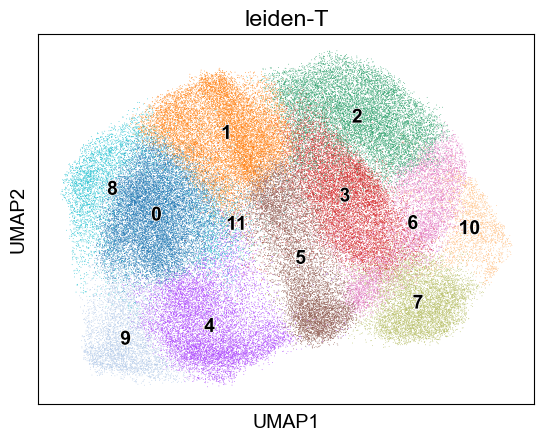

In [15]:
adata_OBC_native = clu(adata_OBC_native, key_added='leiden-T', do_har=True)

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


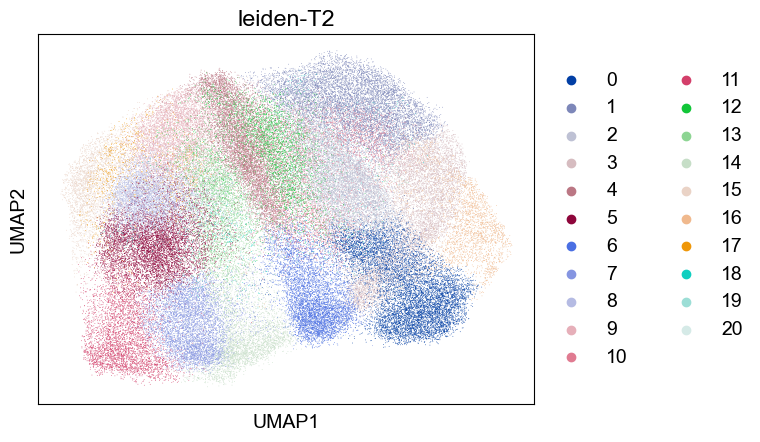

In [20]:
sc.tl.leiden(adata_OBC_native, resolution=2, key_added="leiden-T2")
sc.pl.umap(adata_OBC_native, color=['leiden-T2'])

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


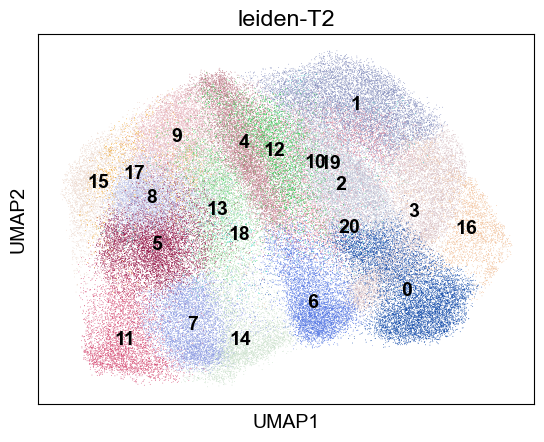

In [21]:
sc.pl.umap(adata_OBC_native, color=['leiden-T2'], legend_loc='on data')

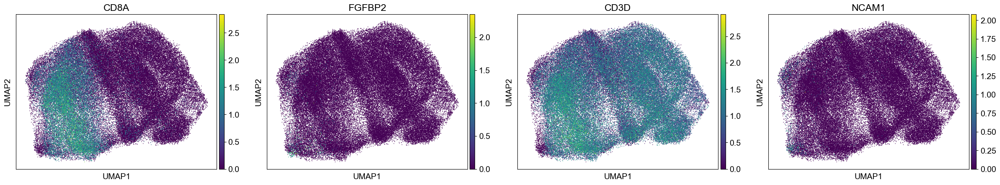

In [62]:
sc.pl.umap(adata_OBC_native, color=['CD8A', 'FGFBP2', 'CD3D', 'NCAM1'], size=5)

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


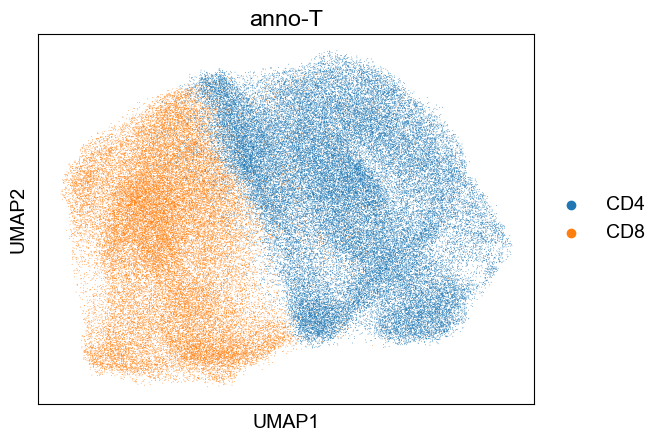

In [24]:
annot = {
  'CD4': ['0', '1', '2', '3', '4', '6', '10', '12', '16', '19', '20'],
  'CD8': ['5', '7', '8', '9', '11', '13', '14', '15', '17', '18']
}
adata_OBC_native = anno(adata_OBC_native, annot, obsKey='anno-T', obsVal='leiden-T2')
sc.pl.umap(adata_OBC_native, color=['anno-T'])

In [25]:
adata_OBC_native_CD8 = adata_OBC_native[adata_OBC_native.obs['anno-T'] == 'CD8']
adata_OBC_native_CD8.write_h5ad("adata-OBC-native-CD8T-3.24.h5ad")
adata_OBC_native_CD4 = adata_OBC_native[adata_OBC_native.obs['anno-T'] == 'CD4']
adata_OBC_native_CD4.write_h5ad("adata-OBC-native-CD4T-3.24.h5ad")

Ignoring processing doublet cells...


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:544: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns['hvg'] = {'flavor': flavor}
/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/anndata.py:1897: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
2025-03-24 07:40:25,113 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-03-24 07:40:39,807 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-03-24 07:40:39,985 - harmonypy - INFO - Iteration 1 of 20
2025-03-24 07:40:49,180 - harmonypy - INFO - Iteration 2 of 20
2025-03-24 07:40:58,276 - harmonypy - INFO - Converged after 2 iterations
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ign

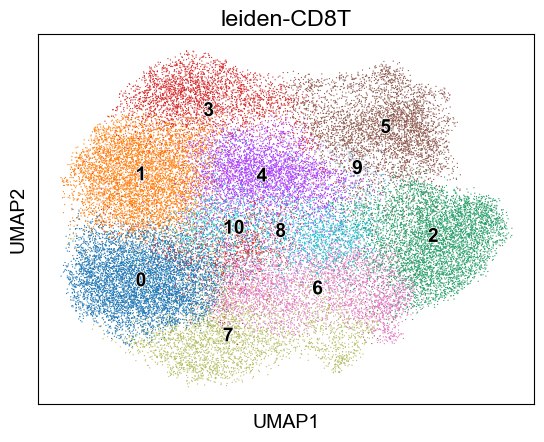

In [26]:
adata_OBC_native_CD8 = clu(adata_OBC_native_CD8, key_added='leiden-CD8T', do_har=True)

In [654]:
adata_OBC_native_CD8.obs['batch']

AAACCTGAGGCTCAGA-1-HER2BC10    HER2BC10
AAACCTGCAATGTTGC-1-HER2BC10    HER2BC10
AAACCTGCAGTCACTA-1-HER2BC10    HER2BC10
AAACCTGCATACAGCT-1-HER2BC10    HER2BC10
AAACCTGCATTCGACA-1-HER2BC10    HER2BC10
                                 ...   
TTTGCGCTCTGCAGTA-1-LABC8          LABC8
TTTGGTTGTTCCACGG-1-LABC8          LABC8
TTTGGTTTCAGTTAGC-1-LABC8          LABC8
TTTGGTTTCCAGATCA-1-LABC8          LABC8
TTTGTCAAGAGCCTAG-1-LABC8          LABC8
Name: batch, Length: 38619, dtype: category
Categories (10, object): ['HER2BC10', 'LABC7', 'LABC8', 'LABC9', ..., 'TNBC3', 'TNBC4', 'TNBC5', 'TNBC6']

In [33]:
sc.tl.leiden(adata_OBC_native_CD8, resolution=1.5, key_added='leiden-CD8T1.5')
sc.tl.leiden(adata_OBC_native_CD8, resolution=2, key_added='leiden-CD8T2')

In [81]:
sc.tl.leiden(adata_OBC_native_CD8, resolution=1.6, key_added='leiden-CD8T1.6')
sc.tl.leiden(adata_OBC_native_CD8, resolution=1.7, key_added='leiden-CD8T1.7')
sc.tl.leiden(adata_OBC_native_CD8, resolution=1.8, key_added='leiden-CD8T1.8')

In [63]:
sc.tl.leiden(adata_OBC_native_CD8, resolution=3, key_added='leiden-CD8T3')

In [ ]:
import scirpy as ir
import muon as mu
adata_OBC_native_ir = sc.read_h5ad("BCM-ir.h5ad")
ir.pp.index_chains(adata_OBC_native_ir)
ir.tl.chain_qc(adata_OBC_native_ir)
adata_OBC_native_tcr = adata_OBC_native_ir[adata_OBC_native_ir.obs['receptor_type'] == 'TCR']
mdata_OBC_native_CD8 = mu.MuData({'gex':adata_OBC_native_CD8, 'airr':adata_OBC_native_tcr})
mdata_OBC_native_CD8

In [56]:
ir.pp.index_chains(mdata_OBC_native_CD8,)
ir.tl.chain_qc(mdata_OBC_native_CD8,)

/home/rzh/BCY/lib/python3.10/site-packages/scirpy/pp/_index_chains.py:142: ImplicitModificationWarning: Setting element `.obsm['chain_indices']` of view, initializing view as actual.
  params.adata.obsm[key_added] = ak.zip(res, depth_limit=1)  # type: ignore


In [59]:
adata_OBC_native_CD8.obs['TCR'] = adata_OBC_native_ir.obs['receptor_type']

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


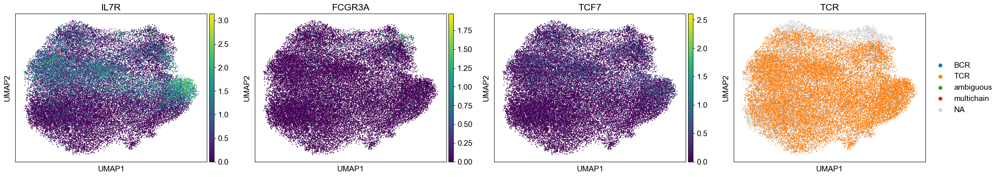

In [70]:
sc.pl.umap(adata_OBC_native_CD8,color=['IL7R', 'FCGR3A', 'TCF7', 'TCR'], size=10)

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


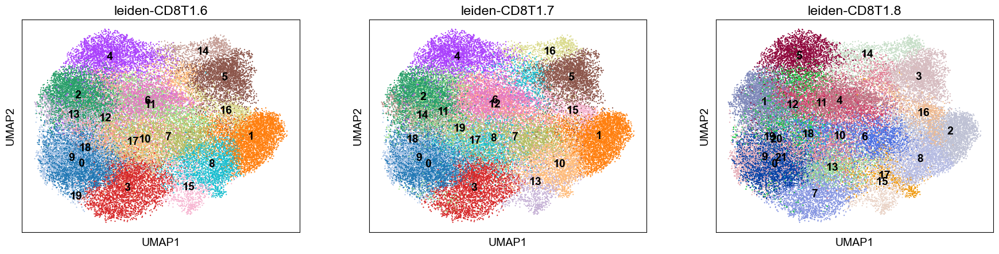

In [82]:
sc.pl.umap(adata_OBC_native_CD8,color=['leiden-CD8T1.6', 'leiden-CD8T1.7','leiden-CD8T1.8'], size=10, legend_loc='on data')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:398: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:401: PerformanceWarning: DataFrame is highly fragmented.  This is usually t

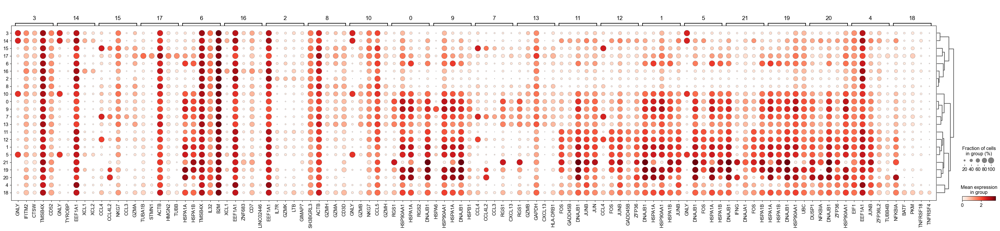

In [84]:
sc.tl.rank_genes_groups(adata_OBC_native_CD8, groupby='leiden-CD8T1.8')
sc.tl.dendrogram(adata_OBC_native_CD8, groupby='leiden-CD8T1.8')
sc.pl.rank_genes_groups_dotplot(adata_OBC_native_CD8, groupby='leiden-CD8T1.8', n_genes=5)

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


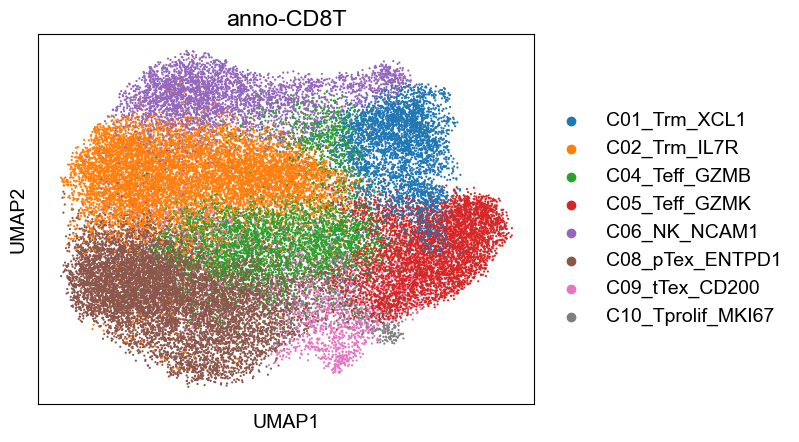

In [97]:
annot = {
  'C01_Trm_XCL1': ['3', '16'],
  'C02_Trm_IL7R': ['1', '4','11', '12'],
  'C04_Teff_GZMB': ['6','10'],
  'C05_Teff_GZMK': ['2','8'],
  'C06_NK_NCAM1': ['5', '14'],
  'C08_pTex_ENTPD1': ['0', '7', '9', '13', '19', '20','21'],
  'C09_tTex_CD200': ['18', '15'],
  'C10_Tprolif_MKI67': ['17'],
}
adata_OBC_native_CD8 = anno(adata_OBC_native_CD8, annot, "anno-CD8T", 'leiden-CD8T1.8')
sc.pl.umap(adata_OBC_native_CD8, color=['anno-CD8T'], size=10)

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


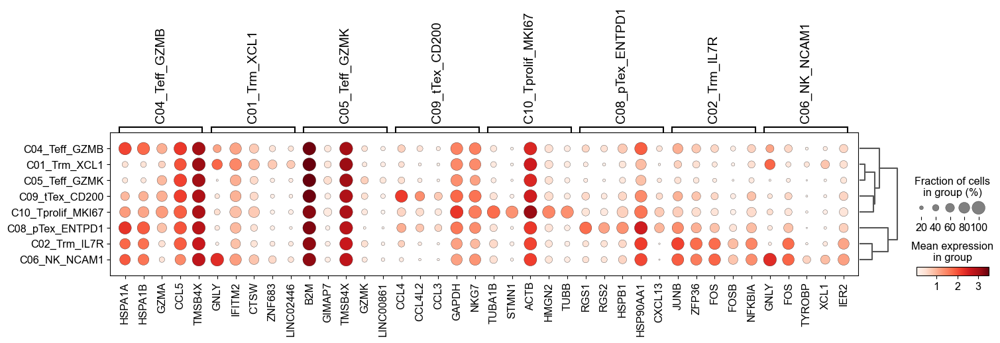

In [98]:
sc.tl.rank_genes_groups(adata_OBC_native_CD8, groupby='anno-CD8T')
sc.tl.dendrogram(adata_OBC_native_CD8, groupby='anno-CD8T')
sc.pl.rank_genes_groups_dotplot(adata_OBC_native_CD8, groupby='anno-CD8T', n_genes=5)

In [99]:
adata_OBC_native_CD8.write_h5ad("adata-OBC-native-CD8T-3.24.h5ad")

Ignoring processing doublet cells...


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:544: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns['hvg'] = {'flavor': flavor}
/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/anndata.py:1897: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
2025-03-24 14:41:23,182 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-03-24 14:41:45,230 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-03-24 14:41:45,592 - harmonypy - INFO - Iteration 1 of 20
2025-03-24 14:42:02,417 - harmonypy - INFO - Iteration 2 of 20
2025-03-24 14:42:19,615 - harmonypy - INFO - Converged after 2 iterations
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ign

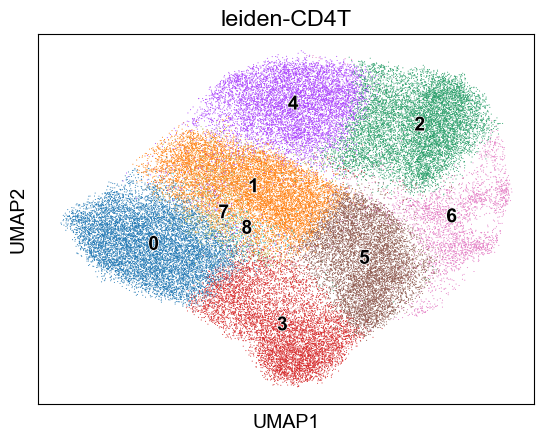

In [100]:
adata_OBC_native_CD4 = clu(adata_OBC_native_CD4, key_added='leiden-CD4T', do_har=True)

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


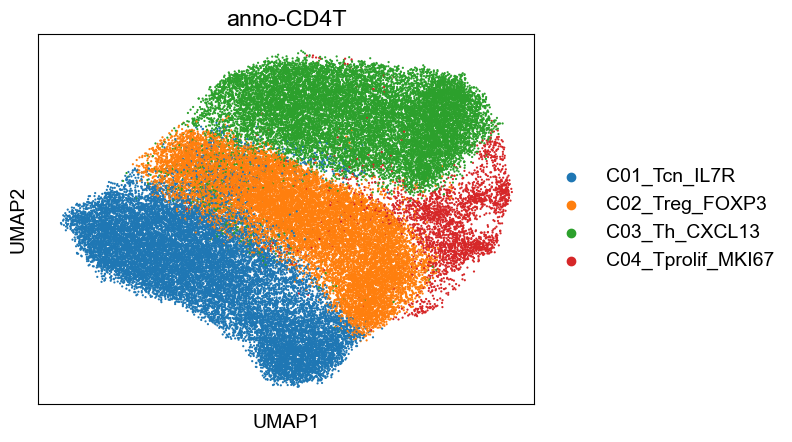

In [108]:
annot = {
  'C01_Tcn_IL7R': ['3', '0', '7', '8'],
  'C02_Treg_FOXP3': ['1', '5'],
  'C03_Th_CXCL13': ['2','4'],
  'C04_Tprolif_MKI67': ['6'],
}
adata_OBC_native_CD4 = anno(adata_OBC_native_CD4, annot, "anno-CD4T", 'leiden-CD4T')
sc.pl.umap(adata_OBC_native_CD4, color=['anno-CD4T'], size=10)

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


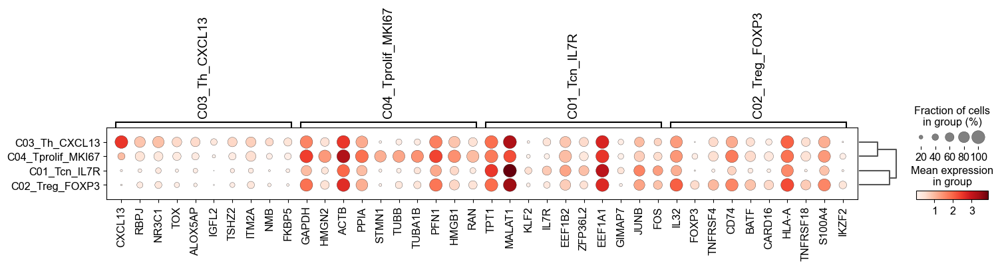

In [109]:
sc.tl.rank_genes_groups(adata_OBC_native_CD4, groupby='anno-CD4T')
sc.tl.dendrogram(adata_OBC_native_CD4, groupby='anno-CD4T')
sc.pl.rank_genes_groups_dotplot(adata_OBC_native_CD4, groupby='anno-CD4T', n_genes=10)

In [112]:
adata_OBC_native_CD8.write_h5ad("adata-OBC-native-CD8T-3.24.h5ad")
adata_OBC_native_CD4.write_h5ad("adata-OBC-native-CD4T-3.24.h5ad")

In [161]:
adata_OBC_exter_CD8

AnnData object with n_obs × n_vars = 7209 × 21864
    obs: 'type', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mito', 'subtype', 'celltype_subset', 'celltype_minor', 'celltype_major', 'batch', 'mt_frac', 'n_genes', 'n_counts', 'doublet_score', 'predicted_doublet', 'leiden-1', 'UCell_B cells', 'UCell_B cells memory', 'UCell_B cells naive', 'UCell_Basophils', 'UCell_Dendritic cells', 'UCell_Eosinophils', 'UCell_Erythroblasts', 'UCell_Erythroid-like and erythroid precursor cells', 'UCell_Gamma delta T cells', 'UCell_Macrophages', 'UCell_Mast cells', 'UCell_Megakaryocytes', 'UCell_Monocytes', 'UCell_Myeloid-derived suppressor cells', 'UCell_NK cells', 'UCell_Natural killer T cells', 'UCell_Neutrophils', 'UCell_Nuocytes', 'UCell_Plasma cells', 'UCell_Plasmacytoid dendritic cells', 'UCell_Platelets', 'UCell_Red pulp macrophages', 'UCell_Reticulocytes', 'UCell_T cells', 'UCell_T cytotoxic cells', 'UCell_T follicular helper cells', 'UCell_T helper cells', 'UCell_T memory cells', 'UCel

In [ ]:
adata_YBC_native_CD8.obs['attr'] = 'YBC_native'
adata_OBC_native_CD8.obs['attr'] = 'OBC_native'
adata_YBC_exter_CD8.obs['attr'] = 'YBC_exter'
adata_OBC_exter_CD8.obs['attr'] = 'OBC_exter'

In [ ]:
adata_OBC_exter_CD8.obs['batch'].cat.categories

Index(['CID3586', 'CID3838', 'CID3921', 'CID3941', 'CID3946', 'CID3948',
       'CID3963', 'CID4040', 'CID4066', 'CID4067', 'CID4290A', 'CID4398',
       'CID4461', 'CID4463', 'CID4465', 'CID4471', 'CID4495', 'CID4513',
       'CID4515', 'CID4523', 'CID4530N', 'CID4535', 'CID44041', 'CID44971',
       'CID44991', 'CID45171'],
      dtype='object')

In [ ]:
annoDict = {
  'Non-tumoral': ['5N', '6N', '10N', '12N', '16N'],
  'TNBC': ['1T', '2T', '3T', '8T', '9T', ],
  'HR+HER2-': ['5T', '6T', '10T', '15T',],
  'HR+HER2+': ['20T', '21T', '22T',],
  'HR-HER2+': ['17T',],
}
adata_YBC_native_CD8 = anno(adata_YBC_native_CD8, annoDict, 'IHC', 'batch')
adata_YBC_native_CD8.obs['IHC'] = adata_YBC_native_CD8.obs['IHC'].astype('category')

In [ ]:
# assign IHC
annoDict = {
  'TNBC': ['CID44991', 'CID4513', 'CID4523', 'CID44971', 'CID4495', 'CID4465','CID44041','CID3946','CID4515'],
  'HR+HER2-': ['CID4535', 'CID4067', 'CID4463', 'CID4530N', 'CID4471', 'CID3948','CID4290A','CID4461','CID3941','CID3963','CID4040','CID4398',],
  'HR+HER2+': ['CID4066', 'CID3586',],
  'HR-HER2+': ['CID45171', 'CID3921', 'CID3838'],
}
adata_OBC_exter_CD8 = anno(adata_OBC_exter_CD8, annoDict, 'IHC', 'batch')
adata_OBC_exter_CD8.obs['IHC'] = adata_OBC_exter_CD8.obs['IHC'].astype('category')

# assign IHC
annoDict = {
  'TNBC': ['TNB1_0177', 'TNB1_0554', 'TNB1_4031'],
  'HR-HER2+': ['HER2_0308'],
}
adata_YBC_exter_CD8 = anno(adata_YBC_exter_CD8, annoDict, 'IHC', 'batch')
adata_YBC_exter_CD8.obs['IHC'] = adata_YBC_exter_CD8.obs['IHC'].astype('category')

# assign IHC
annoDict = {
  'TNBC': ['TNBC1', 'TNBC2', 'TNBC3',
       'TNBC4', 'TNBC5', 'TNBC6'],
  'HR+HER2-': [ 'LABC7', 'LABC8', 'LABC9', ],
  'HR-HER2+': ['HER2BC10']
}
adata_OBC_native_CD8 = anno(adata_OBC_native_CD8, annoDict, 'IHC', 'batch')
adata_OBC_native_CD8.obs['IHC'] = adata_OBC_native_CD8.obs['IHC'].astype('category')

In [177]:
adata1 = adata_YBC_native_CD8[adata_YBC_native_CD8.obs['anno-CD8T'].isin([ 'C08_cTex_ENTPD1', 'C09_tTex_CD200', 'C10_Tprolif_MKI67'])]
adata2 = adata_OBC_native_CD8[adata_OBC_native_CD8.obs['anno-CD8T'].isin([ 'C08_pTex_ENTPD1', 'C09_tTex_CD200', 'C10_Tprolif_MKI67'])]
adata3 = adata_YBC_exter_CD8[adata_YBC_exter_CD8.obs['anno-CD8T'].isin([ 'C08_Tex_PDCD1', 'C10_Tprolif_MKI67'])]
adata4 = adata_OBC_exter_CD8[adata_OBC_exter_CD8.obs['anno-CD8T'].isin(['C08_Tex_ENTPD1', 'C09_Tprolif_MKI67'])]
adata_Tex = adata1.concatenate([adata2, adata3, adata4], batch_key='attr', batch_categories=['YBC_native', 'OBC_native', 'YBC_exter', 'OBC_exter'])
adata_Tex

/tmp/ipykernel_4178142/2185487106.py:5: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  adata_Tex = adata1.concatenate([adata2, adata3, adata4], batch_key='attr', batch_categories=['YBC_native', 'OBC_native', 'YBC_exter', 'OBC_exter'])
/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/merge.py:1337: UserWarning: Only some AnnData objects have `.raw` attribute, not concatenating `.raw` attributes.
  warn(
/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/anndata.py:1897: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/anndata.py:1897: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_du

AnnData object with n_obs × n_vars = 18132 × 16958
    obs: 'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden', 'major_type', 'molecular_type', 'leiden_harmony', 'major_type_harmony', 'minor_type', 'minor-type', 'gender', 'doublet_score', 'predicted_doublet', 'leiden-harmony-female', 'majorType-Female', 'epi-subtype', 'majorType-fix', 'leiden-T', 'leiden-Tmix', 'leiden-CD8T', 'anno-CD8T', 'sample', 'tech', 'anno-CD8T-har', 'cptype', 'cytotoxicity', 'MANAscore', 'exhaustion', 'CytoTRACE2_Score', 'CytoTRACE2_Potency', 'CytoTRACE2_Relative', 'preKNN_CytoTRACE2_Score', 'preKNN_CytoTRACE2_Potency', 'major-type', 'leiden-major', 'leiden-gex', 'leiden-T1.5', 'leiden-T2', 'anno-T', 'leiden-CD8T1.5', 'leiden-CD8T2', 'TCR', 'leiden-CD8T3', 'leiden-CD8T1.6', 'leiden-CD8T1.7', 'leiden-CD8T1.8', 'type', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mito', 'subtype', 'celltype_subset', 'celltype_minor', 'ce

In [ ]:
annoDict = {
  'Non-tumoral': ['5N', '6N', '10N', '12N', '16N'],
  'TNBC': ['1T', '2T', '3T', '8T', '9T', 'CID44991', 'CID4513', 'CID4523', 'CID44971', 'CID4495', 'CID4465','CID44041','CID3946','TNB1_0177', 'TNB1_0554', 'TNB1_4031', 'CID4515', 'TNBC1', 'TNBC2', 'TNBC3',
       'TNBC4', 'TNBC5', 'TNBC6'],
  'HR+HER2-': ['5T', '6T', '10T', '15T', 'CID4535', 'CID4067', 'CID4463', 'CID4530N', 'CID4471', 'CID3948','CID4290A','CID4461','CID3941','CID3963','CID4040','CID4398','LABC7', 'LABC8', 'LABC9', ],
  'HR+HER2+': ['20T', '21T', '22T', 'CID4066', 'CID3586',],
  'HR-HER2+': ['17T', 'CID45171', 'CID3921','HER2_0308','HER2BC10','CID3838'],
}
adata_Tex = anno(adata_Tex, annoDict, 'IHC', 'batch')
adata_Tex.obs['IHC'] = adata_Tex.obs['IHC'].astype('category')
adata_Tex.obs['IHC']

ACGCACGCAATGCAGG-1T-YBC_native                      TNBC
ACTGTGAGTCGCTTAA-1T-YBC_native                      TNBC
ATTCAGGCATAGGTAA-1T-YBC_native                      TNBC
CAAGACTTCCGGTTCT-1T-YBC_native                      TNBC
CCACACTGTCTTAGTG-1T-YBC_native                      TNBC
                                                  ...   
CID4495_ATCCACCTCTTGTACT-CID4495-OBC_exter          TNBC
CID4513_CTCGGAGTCCTATTCA-CID4513-OBC_exter          TNBC
CID44971_AACCATGAGTACATGA-CID44971-OBC_exter        TNBC
CID45171_GGTGTTAGTATCACCA-CID45171-OBC_exter    HR-HER2+
CID44971_GGACGTCAGCCATCGC-CID44971-OBC_exter        TNBC
Name: IHC, Length: 18132, dtype: category
Categories (5, object): ['HR+HER2+', 'HR+HER2-', 'HR-HER2+', 'Non-tumoral', 'TNBC']

Ignoring processing doublet cells...


2025-03-25 09:29:42,468 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-03-25 09:29:50,286 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-03-25 09:29:50,390 - harmonypy - INFO - Iteration 1 of 20
2025-03-25 09:29:56,062 - harmonypy - INFO - Iteration 2 of 20
2025-03-25 09:30:02,153 - harmonypy - INFO - Converged after 2 iterations
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


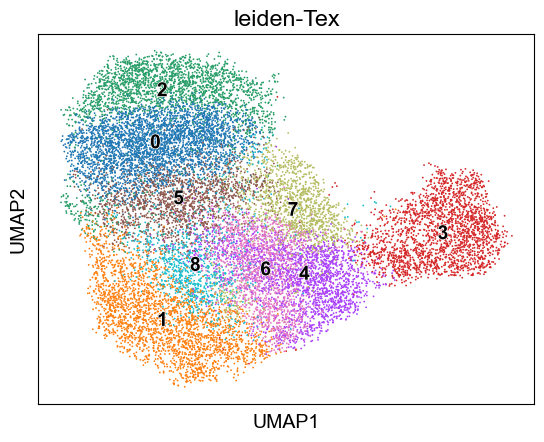

In [178]:
adata_Tex = clu(adata_Tex, key_added='leiden-Tex', do_har=True)

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


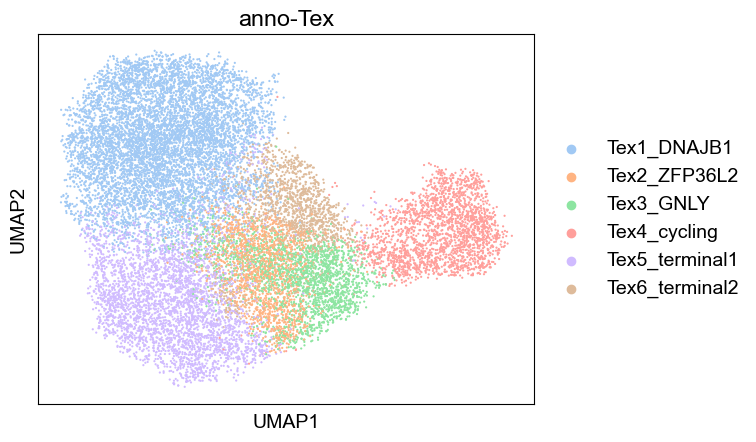

In [ ]:
annot = {
  'Tex1_DNAJB1': ['0', '2', '5'],
  'Tex2_ZFP36L2': ['6'],
  'Tex3_GNLY': ['4'],
  'Tex4_cycling': ['3'],
  'Tex5_terminal1': ['1', '8'],
  'Tex6_terminal2': ['7'],
}
adata_Tex = anno(adata_Tex, annot, "anno-Tex", 'leiden-Tex')
sc.pl.umap(adata_Tex, color=['anno-Tex'], size=10)

In [ ]:
sc.tl.rank_genes_groups(adata_Tex, groupby='anno-Tex')
sc.tl.dendrogram(adata_Tex, groupby='anno-Tex')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


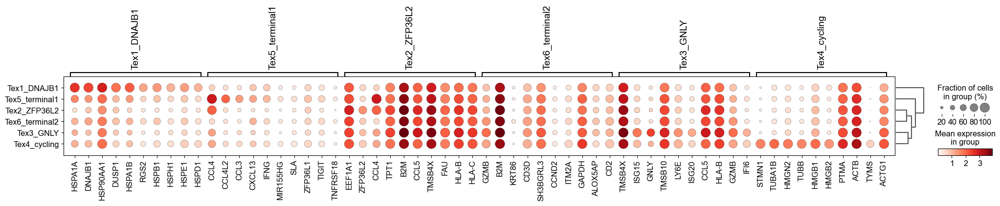

In [ ]:
sc.pl.rank_genes_groups_dotplot(adata_Tex)

In [ ]:
sc.tl.leiden(adata_Tex, resolution=1.6, key_added='leiden-Tex1.6')
sc.tl.leiden(adata_Tex, resolution=1.7, key_added='leiden-Tex1.7')
sc.tl.leiden(adata_Tex, resolution=1.8, key_added='leiden-Tex1.8')
sc.tl.leiden(adata_Tex, resolution=2.0, key_added='leiden-Tex2.0')

In [ ]:
def propPlot(age_df, barlabels, ax, colors=sc.pl.palettes.default_20, xlabel='Patient ID', show_y=True, xrotate=90):
    all_df = age_df.sum(axis=1)
    age_normdf = pd.DataFrame([age_df.loc[i,:]/all_df[i] for i in barlabels], index=barlabels)
    age_cumdf = pd.DataFrame([np.cumsum(age_normdf.loc[i,:]) for i in barlabels], index=barlabels)
    norm_gdfs = age_normdf
    cum_gdfs = age_cumdf
    for i, col in enumerate(age_df.columns):
        height = norm_gdfs[col]
        starts = cum_gdfs[col] - height
        rects = ax.barh(barlabels, height, left=starts, height=0.9, color=colors[i], edgecolor='white', linewidth=0.5,
                        label=col, alpha=1)
    
        # ax.bar_label(rects,age_df.loc[:, col], label_type='center', color='lightgrey', fontsize=14)
    ax.legend( bbox_to_anchor=(1, 0.3), 
              handletextpad=0.5, frameon=False,
                          borderpad=0.4,
                          columnspacing=1,
                          handlelength=0.65,
              loc='lower left')
    if show_y:
        ax.xaxis.set_major_formatter(ticker.PercentFormatter(xmax=1,decimals=0))
        ax.set_xlabel('Cell proportions')
    else:
        ax.yaxis.set_visible(False)
    ax.set_ylabel(xlabel)
    # ax.set_yticks(barlabels)
    # ax.set_xticklabels(labels=barlabels,rotation=xrotate)
    ax.spines.top.set_visible(False)
    ax.spines.right.set_visible(False)

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


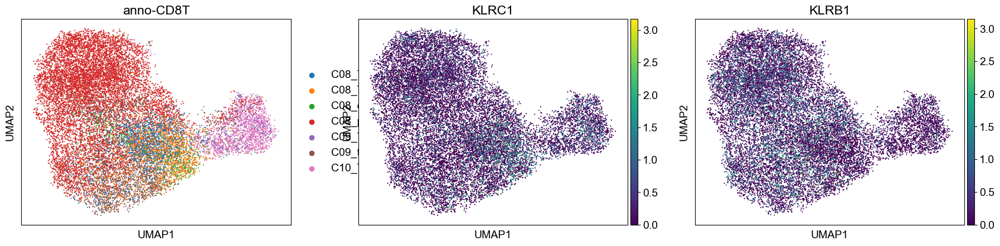

In [ ]:
sc.pl.umap(adata_Tex, color=['anno-CD8T', 'KLRC1', 'KLRB1'], size=10)

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


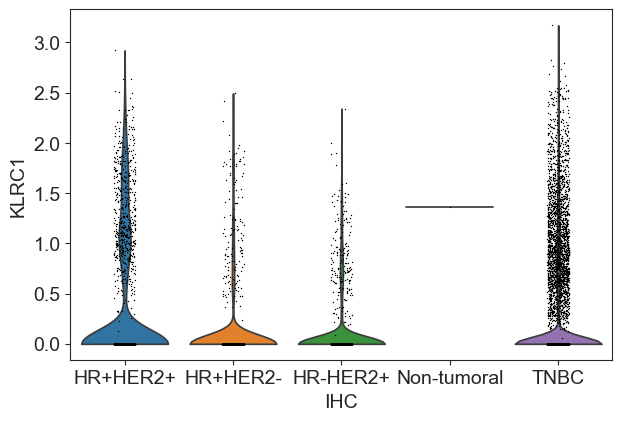

In [ ]:
sc.pl.violin(adata_Tex, keys=['KLRC1'], groupby='IHC')

In [ ]:
import memento
import anndata as ad
import pandas as pd
def DE_memento_1d(adata: ad.AnnData, ctleft: list, ctright: list, groupby='annotation'):
  """
  使用 Memento 包分析单细胞测序数据中的动态变化。

  Args:
      adata (ad.AnnData): 单细胞测序数据的 AnnData 对象。
      ctleft (list): 左条件列表，表示刺激前的细胞类型或状态。
      ctright (list): 右条件列表，表示刺激后的细胞类型或状态。
      groupby (str, optional): 用于分组的注释列名。默认为 'annotation'。

  Returns:
      pd.DataFrame: Memento 分析的结果，包括差异表达分析、HT 1D moments 分析等。

  """
  _adata = adata[adata.obs[groupby].isin(ctleft + ctright)].copy()
  _adata.obs['stim'] = _adata.obs[groupby].isin(ctright)
  _adata.obs['stim'] = _adata.obs['stim'].astype('int')
  _adata.obs['capture_rate'] = 0.07
  memento.setup_memento(_adata, q_column='capture_rate')
  memento.create_groups(_adata, label_columns=['stim'])
  memento.compute_1d_moments(_adata, min_perc_group=.5)
  meta_df = memento.get_groups(_adata)
  meta_df['intercept'] = 1
  convariate = meta_df[['intercept']]
  treatment = (meta_df[['stim']] == 1).astype(float)
  
  memento.ht_1d_moments(_adata,
  covariate=convariate,
  treatment=treatment,
  num_cpus=16,
  resample_rep=False,
  )
  memento_results = memento.get_1d_ht_result(_adata)
  return(memento_results)

In [ ]:
de_attr = DE_memento_1d(adata_Tex, ctleft=['YBC_native', 'YBC_exter',], ctright=['OBC_native','OBC_exter'], groupby='attr')

/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/anndata.py:1897: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/anndata.py:1897: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
/home/rzh/BCY/lib/python3.10/site-packages/setuptools_scm/_integration/setuptools.py:30: RuntimeWarning: 
ERROR: setuptools==59.6.0 is used in combination with setuptools_scm>=8.x

Your build configuration is incomplete and previously worked by accident!
setuptools_scm requires setuptools>=61

Suggested workaround if applicable:
 - migrating from the deprecated setup_requires mechanism to pep517/518
   and using a pyproject.toml to declare build dependencies
   which are reliably pre-installed befo

In [ ]:
adata_Tex.obs['anno-Tex']

ACGCACGCAATGCAGG-1T-YBC_native                      Tex2_inf
ACTGTGAGTCGCTTAA-1T-YBC_native                     Tex5_term
ATTCAGGCATAGGTAA-1T-YBC_native                     Tex3_cyto
CAAGACTTCCGGTTCT-1T-YBC_native                  Tex4_cycling
CCACACTGTCTTAGTG-1T-YBC_native                      Tex2_inf
                                                    ...     
CID4495_ATCCACCTCTTGTACT-CID4495-OBC_exter      Tex4_cycling
CID4513_CTCGGAGTCCTATTCA-CID4513-OBC_exter         Tex5_term
CID44971_AACCATGAGTACATGA-CID44971-OBC_exter        Tex2_inf
CID45171_GGTGTTAGTATCACCA-CID45171-OBC_exter        Tex2_inf
CID44971_GGACGTCAGCCATCGC-CID44971-OBC_exter    Tex6_unknown
Name: anno-Tex, Length: 18132, dtype: category
Categories (6, object): ['Tex1_stress', 'Tex2_inf', 'Tex3_cyto', 'Tex4_cycling', 'Tex5_term', 'Tex6_unknown']

In [ ]:
de_anno = DE_memento_1d(adata_Tex, ctleft=['Tex5_term',], ctright=['Tex1_stress', 'Tex2_inf', 'Tex3_cyto', 'Tex4_cycling', 'Tex6_unknown'], groupby='anno-Tex')

/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/anndata.py:1897: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/anndata.py:1897: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done  18 tasks      | elapsed:    6.4s
[Parallel(n_jobs=16)]: Done  66 out of  66 | elapsed:   26.9s finished


In [ ]:
len(set(de_attr['gene']).intersection(set(de_anno['gene'])))

28

In [ ]:
de_genes = list(set(de_attr['gene']).intersection(set(de_anno['gene'])))
de_df1 = de_attr.loc[de_attr['gene'].isin(de_genes), ['gene', 'de_coef', 'de_pval']]
de_df1.columns = ['gene', 'de_coef_attr', 'de_pval_attr']
de_df1['-log10_de_pval_attr'] = -np.log10(de_df1['de_pval_attr']+10e-200)
de_df2 = de_anno.loc[de_anno['gene'].isin(de_genes), ['gene', 'de_coef', 'de_pval']]
de_df2.columns = ['gene', 'de_coef_anno', 'de_pval_anno']
de_df2['-log10_de_pval_anno'] = -np.log10(de_df2['de_pval_anno'])
de_df = pd.merge(de_df1, de_df2, on='gene')
de_df

/home/rzh/BCY/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


,gene,de_coef_attr,de_pval_attr,-log10_de_pval_attr,de_coef_anno,de_pval_anno,-log10_de_pval_anno
0,XCL2,-0.064458,1.882503e-01,0.725264,-0.341593,2.014207e-09,8.695896
1,XCL1,0.257043,2.732143e-06,5.563497,-0.288735,2.163679e-07,6.664807
2,STMN1,-0.372287,2.566767e-30,29.590614,0.827765,1.713222e-59,58.766186
3,HSPA6,1.745905,1.410474e-213,199.000000,0.561241,1.410324e-39,38.850681
4,ZNF683,-0.611560,1.060157e-91,90.974630,0.747674,1.414038e-56,55.849539
5,ZFP36L2,-0.025066,2.269620e-01,0.644047,0.397459,1.192271e-55,54.923625
6,CXCR4,0.126379,2.422806e-08,7.615681,0.610492,7.301144e-90,89.136609
7,IGKC,-1.947581,0.000000e+00,199.000000,0.321273,7.599112e-09,8.119237
8,GNLY,-1.628890,0.000000e+00,199.000000,0.345100,1.584865e-21,20.800008
9,MTRNR2L12,-0.659588,2.125018e-32,31.672637,0.236321,2.738413e-03,2.562501


In [ ]:
palette = sns.color_palette("pastel", 5)

In [ ]:
import seaborn as sns

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


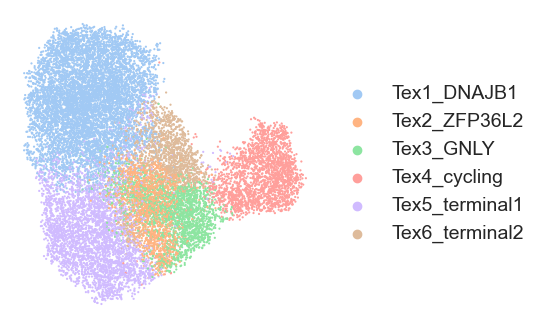

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
palette = sns.color_palette("pastel", 6)
sc.pl.umap(adata_Tex, color=['anno-Tex'],palette=palette, size=10,title='', ax=ax, show=False)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xlabel("")
ax.set_ylabel("")
fig.savefig(f'{figPath}/anno_Tex.png', dpi=400, bbox_inches='tight')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


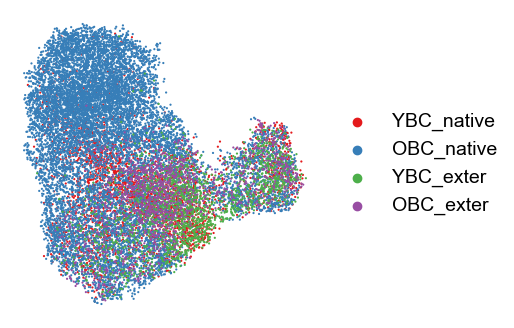

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
palette = sns.color_palette("Set1", 4)
sc.pl.umap(adata_Tex, color=['attr'],palette=palette, size=10,title='', ax=ax, show=False)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xlabel("")
ax.set_ylabel("")
fig.savefig(f'{figPath}/Tex_batch.png', dpi=400, bbox_inches='tight')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_utils.py:431: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_utils.py:431: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_utils.py:431: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initial

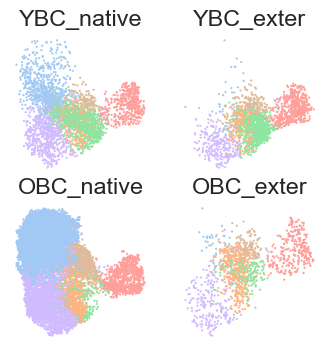

In [ ]:
fig, ax = plt.subplots(2, 2, figsize=(4, 4))
palette = sns.color_palette("pastel", 6)
for i, attr in enumerate(['YBC_native', 'YBC_exter', 'OBC_native', 'OBC_exter']):
  x, y = int(i/2), i%2
  sc.pl.umap(adata_Tex[adata_Tex.obs['attr']==attr], color=['anno-Tex'],
             palette=palette, size=10,title=attr, ax=ax[x][y], show=False)
  ax[x][y].spines['right'].set_visible(False)
  ax[x][y].spines['top'].set_visible(False)
  ax[x][y].spines['left'].set_visible(False)
  ax[x][y].spines['bottom'].set_visible(False)
  ax[x][y].set_xlabel("")
  ax[x][y].set_ylabel("")
  ax[x][y].legend_.set_visible(False)
  fig.savefig(f'{figPath}/Tex_batch.png', dpi=400, bbox_inches='tight')

In [ ]:
adata_NK

AnnData object with n_obs × n_vars = 9391 × 16958
    obs: 'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden', 'major_type', 'molecular_type', 'leiden_harmony', 'major_type_harmony', 'minor_type', 'minor-type', 'gender', 'doublet_score', 'predicted_doublet', 'leiden-harmony-female', 'majorType-Female', 'epi-subtype', 'majorType-fix', 'leiden-T', 'leiden-Tmix', 'leiden-CD8T', 'anno-CD8T', 'sample', 'tech', 'anno-CD8T-har', 'cptype', 'cytotoxicity', 'MANAscore', 'exhaustion', 'CytoTRACE2_Score', 'CytoTRACE2_Potency', 'CytoTRACE2_Relative', 'preKNN_CytoTRACE2_Score', 'preKNN_CytoTRACE2_Potency', 'IHC', 'major-type', 'leiden-major', 'leiden-gex', 'leiden-T1.5', 'leiden-T2', 'anno-T', 'leiden-CD8T1.5', 'leiden-CD8T2', 'TCR', 'leiden-CD8T3', 'leiden-CD8T1.6', 'leiden-CD8T1.7', 'leiden-CD8T1.8', 'type', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mito', 'subtype', 'celltype_subset', 'celltype_minor

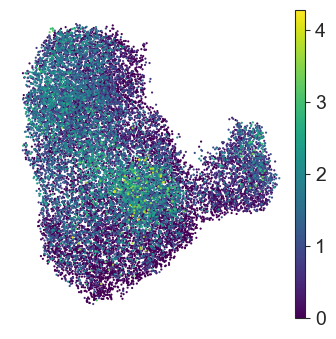

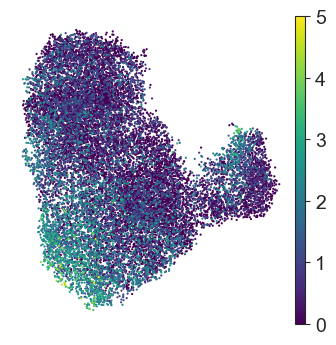

In [ ]:
for gene in ['CXCR4', 'CCL3']:# 'KLRC1', 'KLRB1', 'DNAJB1', 'CCL3', 'GNLY', 'STMN1', 'CXCL13', 'CD200'
  fig, ax = plt.subplots(1, 1, figsize=(4, 4))
  sc.pl.umap(adata_Tex, color=gene, size=10, ax=ax, show=False, cmap='viridis')
  ax.spines['right'].set_visible(False)
  ax.spines['top'].set_visible(False)
  ax.spines['left'].set_visible(False)
  ax.spines['bottom'].set_visible(False)
  ax.set_xlabel("")
  ax.set_title('')
  ax.set_ylabel("")
  # ax.legend(  handletextpad=0.5, frameon=False,
  #                     borderpad=0.6,
  #                     columnspacing=1.3,
  #                     handlelength=0.65, fontsize=12)
  fig.savefig(f"{figPath}/Tex-Markers-{gene}.png", dpi=400, bbox_inches='tight')

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
palette = sns.color_palette("pastel", 6)
sc.pl.umap(adata_Tex, color=['anno-Tex'],palette=palette, size=10,title='', ax=ax, show=False)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xlabel("")
ax.set_ylabel("")
fig.savefig(f'{figPath}/anno_Tex.png', dpi=400, bbox_inches='tight')

In [ ]:
import anndata2ri
import rpy2.rinterface_lib.callbacks
import logging

In [ ]:
# Ignore R warning messages
#Note: this can be commented out to get more verbose R output
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)
anndata2ri.activate()

/tmp/ipykernel_4178142/3599733125.py:4: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  anndata2ri.activate()


In [ ]:
%load_ext rpy2.ipython

In [ ]:
%%R -i de_attr
library(ggVolcano)
library(RColorBrewer)
library(ggsci)
data <- add_regulate(de_attr, log2FC_name = "de_coef",
                     fdr_name = "de_pval",log2FC = 0.4, fdr = 0.05)
# plot
p <- ggvolcano(data, x = "log2FoldChange", y = "padj",
          label = "gene", label_number = 20, 
          output = FALSE, legend_position = "UL",
          log2FC_cut = 0.4, FDR_cut = 0.05) +
    labs(x="correlation", y="-log P-value")
ggsave("~/figure-1.23/DE_Tex_attr.pdf", p, width = 3, height = 3, units = "in")

In [ ]:
%%R -i de_anno
library(ggVolcano)
library(RColorBrewer)
library(ggsci)
data <- add_regulate(de_anno, log2FC_name = "de_coef",
                     fdr_name = "de_pval",log2FC = 0.4, fdr = 0.05)
# plot
p <- ggvolcano(data, x = "log2FoldChange", y = "padj",
          label = "gene", label_number = 20, 
          output = FALSE, legend_position = "UL",
          log2FC_cut = 0.4, FDR_cut = 0.05) +
    labs(x="correlation", y="-log P-value")
ggsave("~/figure-1.23/DE_Tex_anno.pdf", p, width = 3, height = 3, units = "in")

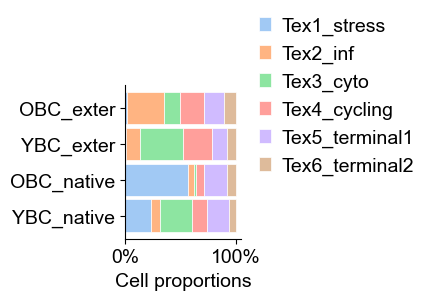

In [ ]:
barlabels = list(adata_Tex.obs['attr'].unique())
cell_types = list(adata_Tex.obs['anno-Tex'].unique())
cell_types.sort()
colors = sns.color_palette("pastel", 6)
# colors = ['#66c2a5', '#fc8d62', '#8da0cb', '#e78ac3', '#a6d854', '#ffd92f', '#e5c494', '#b3b3b3']
age_df = pd.DataFrame(columns = list(cell_types))
for bar in barlabels:
    d1 = pd.DataFrame([((adata_Tex.obs["anno-Tex"] == ct) & (adata_Tex.obs["attr"] == bar)).sum() for ct in list(cell_types)], index = list(cell_types), columns=[bar]).T
    age_df = pd.concat([age_df, d1])
fig0, ax0 = plt.subplots(figsize=(1.5, 2))
propPlot(age_df, ax=ax0, barlabels=barlabels, xlabel='', colors=colors)
fig0.savefig(f"{figPath}/Tex_attr_proportions.svg",bbox_inches='tight')

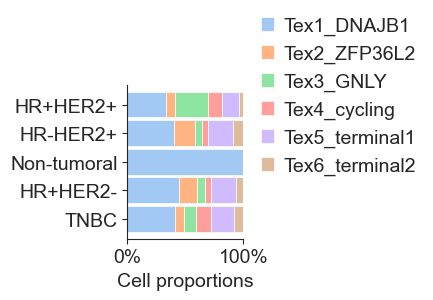

In [ ]:
barlabels = list(adata_Tex.obs['IHC'].unique())
cell_types = list(adata_Tex.obs['anno-Tex'].unique())
cell_types.sort()
colors = sns.color_palette("pastel", 6)
# colors = ['#66c2a5', '#fc8d62', '#8da0cb', '#e78ac3', '#a6d854', '#ffd92f', '#e5c494', '#b3b3b3']
age_df = pd.DataFrame(columns = list(cell_types))
for bar in barlabels:
    d1 = pd.DataFrame([((adata_Tex.obs["anno-Tex"] == ct) & (adata_Tex.obs["IHC"] == bar)).sum() for ct in list(cell_types)], index = list(cell_types), columns=[bar]).T
    age_df = pd.concat([age_df, d1])
fig0, ax0 = plt.subplots(figsize=(1.5, 2))
propPlot(age_df, ax=ax0, barlabels=barlabels, xlabel='', colors=colors)
fig0.savefig(f"{figPath}/Tex_IHC_proportions.svg",bbox_inches='tight')

/tmp/ipykernel_4178142/837631878.py:13: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax0.set_yticklabels(['Tex1', 'Tex2', 'Tex3', 'Tex4', 'Tex5', 'Tex6'])


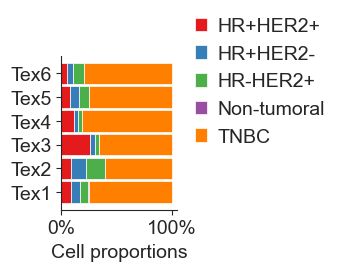

In [ ]:
barlabels = list(adata_Tex.obs['anno-Tex'].unique())
barlabels.sort()
cell_types = list(adata_Tex.obs['IHC'].unique())
cell_types.sort()
colors = sns.color_palette("Set1", 6)
# colors = ['#66c2a5', '#fc8d62', '#8da0cb', '#e78ac3', '#a6d854', '#ffd92f', '#e5c494', '#b3b3b3']
age_df = pd.DataFrame(columns = list(cell_types))
for bar in barlabels:
    d1 = pd.DataFrame([((adata_Tex.obs["IHC"] == ct) & (adata_Tex.obs["anno-Tex"] == bar)).sum() for ct in list(cell_types)], index = list(cell_types), columns=[bar]).T
    age_df = pd.concat([age_df, d1])
fig0, ax0 = plt.subplots(figsize=(1.5, 2))
propPlot(age_df, ax=ax0, barlabels=barlabels, xlabel='', colors=colors)
ax0.set_yticklabels(['Tex1', 'Tex2', 'Tex3', 'Tex4', 'Tex5', 'Tex6'])
fig0.savefig(f"{figPath}/Tex_anno-Tex_proportions.svg",bbox_inches='tight')

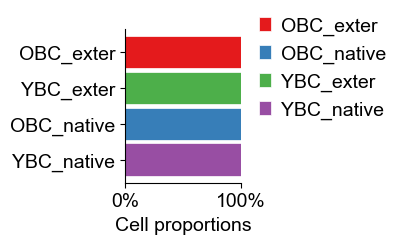

In [ ]:
barlabels = list(adata_Tex.obs['attr'].unique())
cell_types = list(adata_Tex.obs['attr'].unique())
cell_types.sort()
colors = sns.color_palette("Set1", 4)
# colors = ['#66c2a5', '#fc8d62', '#8da0cb', '#e78ac3', '#a6d854', '#ffd92f', '#e5c494', '#b3b3b3']
age_df = pd.DataFrame(columns = list(cell_types))
for bar in barlabels:
    d1 = pd.DataFrame([((adata_Tex.obs["attr"] == ct) & (adata_Tex.obs["attr"] == bar)).sum() for ct in list(cell_types)], index = list(cell_types), columns=[bar]).T
    age_df = pd.concat([age_df, d1])
fig0, ax0 = plt.subplots(figsize=(1.5, 2))
propPlot(age_df, ax=ax0, barlabels=barlabels, xlabel='', colors=colors)
fig0.savefig(f"{figPath}/Tex_attr_colors.svg",bbox_inches='tight')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


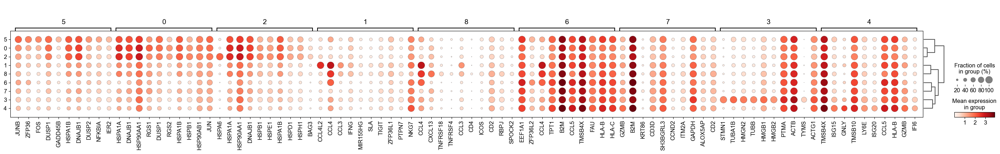

In [186]:
sc.tl.rank_genes_groups(adata_Tex, groupby='leiden-Tex')
sc.tl.dendrogram(adata_Tex, groupby='leiden-Tex')
sc.pl.rank_genes_groups_dotplot(adata_Tex, groupby='leiden-Tex', n_genes=10, groups=['6'])

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


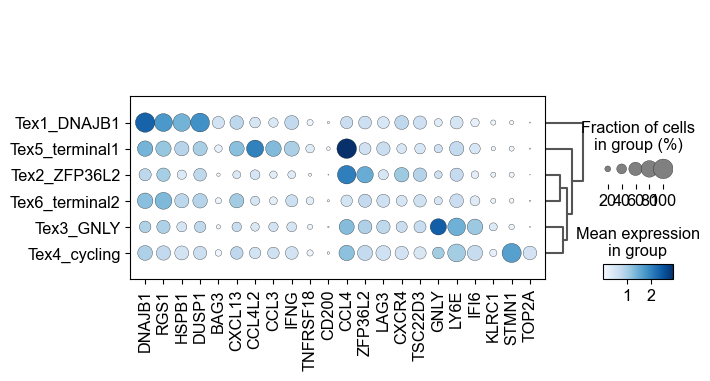

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(7, 3.5))
sc.pl.rank_genes_groups_dotplot(adata_Tex, groupby='anno-Tex',cmap='Blues', ax=ax,
                                var_names=['DNAJB1', 'RGS1', 'HSPB1', 'DUSP1', 'BAG3', 
                                           'CXCL13', 'CCL4L2', 'CCL3', 'IFNG', 'TNFRSF18', 'CD200',
                                           'CCL4', 'ZFP36L2', 'LAG3', 'CXCR4', 'TSC22D3',
                                           'GNLY', 'LY6E', 'IFI6', 'KLRC1', 'STMN1', 'TOP2A'])
fig.savefig(f"{figPath}/Tex_markers.svg", bbox_inches='tight')

In [ ]:
adata_OBC_exter_CD8.obs['anno-CD8T'].cat.categories

Index(['C01_Trm_XCL1', 'C02_Trm_IL7R', 'C03_Trm_ISG15', 'C04_Teff_IFNG',
       'C05_Teff_GZMK', 'C06_NK_NCAM1', 'C07_NKT_FGFBP2', 'C08_Tex_ENTPD1',
       'C09_Tprolif_MKI67'],
      dtype='object')

In [ ]:
adata1 = adata_YBC_native_CD8[adata_YBC_native_CD8.obs['anno-CD8T'].isin([ 'C01_Trm_XCL1',])]
adata2 = adata_OBC_native_CD8[adata_OBC_native_CD8.obs['anno-CD8T'].isin([ 'C01_Trm_XCL1', ])]
adata3 = adata_YBC_exter_CD8[adata_YBC_exter_CD8.obs['anno-CD8T'].isin([ 'C01_Trm_XCL1',  ])]
adata4 = adata_OBC_exter_CD8[adata_OBC_exter_CD8.obs['anno-CD8T'].isin(['C01_Trm_XCL1',])]
adata_XCL1 = adata1.concatenate([adata2, adata3, adata4], batch_key='attr', batch_categories=['YBC_native', 'OBC_native', 'YBC_exter', 'OBC_exter'])
adata_XCL1

/tmp/ipykernel_4178142/2559573056.py:5: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  adata_XCL1 = adata1.concatenate([adata2, adata3, adata4], batch_key='attr', batch_categories=['YBC_native', 'OBC_native', 'YBC_exter', 'OBC_exter'])
/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/merge.py:1337: UserWarning: Only some AnnData objects have `.raw` attribute, not concatenating `.raw` attributes.
  warn(
/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/anndata.py:1897: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/anndata.py:1897: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_d

AnnData object with n_obs × n_vars = 9869 × 16958
    obs: 'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden', 'major_type', 'molecular_type', 'leiden_harmony', 'major_type_harmony', 'minor_type', 'minor-type', 'gender', 'doublet_score', 'predicted_doublet', 'leiden-harmony-female', 'majorType-Female', 'epi-subtype', 'majorType-fix', 'leiden-T', 'leiden-Tmix', 'leiden-CD8T', 'anno-CD8T', 'sample', 'tech', 'anno-CD8T-har', 'cptype', 'cytotoxicity', 'MANAscore', 'exhaustion', 'CytoTRACE2_Score', 'CytoTRACE2_Potency', 'CytoTRACE2_Relative', 'preKNN_CytoTRACE2_Score', 'preKNN_CytoTRACE2_Potency', 'major-type', 'leiden-major', 'leiden-gex', 'leiden-T1.5', 'leiden-T2', 'anno-T', 'leiden-CD8T1.5', 'leiden-CD8T2', 'TCR', 'leiden-CD8T3', 'leiden-CD8T1.6', 'leiden-CD8T1.7', 'leiden-CD8T1.8', 'type', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mito', 'subtype', 'celltype_subset', 'celltype_minor', 'cel

Ignoring processing doublet cells...


2025-04-02 12:49:41,875 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-04-02 12:49:47,790 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-04-02 12:49:49,710 - harmonypy - INFO - Iteration 1 of 20
2025-04-02 12:49:54,503 - harmonypy - INFO - Iteration 2 of 20
2025-04-02 12:49:56,497 - harmonypy - INFO - Converged after 2 iterations
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


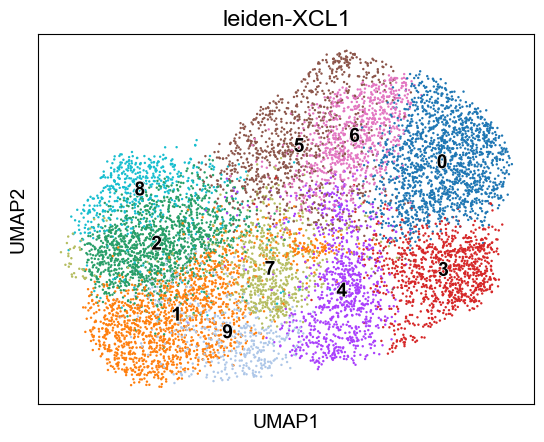

In [ ]:
adata_XCL1 = clu(adata_XCL1, key_added='leiden-XCL1', do_har=True, har_key='attr')

In [ ]:
adata1 = adata_YBC_native_CD8[adata_YBC_native_CD8.obs['anno-CD8T'].isin([ 'C06_NK_NCAM1','C07_NKT_FGFBP2'])]
adata2 = adata_OBC_native_CD8[adata_OBC_native_CD8.obs['anno-CD8T'].isin([ 'C06_NK_NCAM1', ])]
adata3 = adata_YBC_exter_CD8[adata_YBC_exter_CD8.obs['anno-CD8T'].isin([ 'C06_NK_NCAM1',  'C07_NKT_FGFBP2'])]
adata4 = adata_OBC_exter_CD8[adata_OBC_exter_CD8.obs['anno-CD8T'].isin(['C06_NK_NCAM1',  'C07_NKT_FGFBP2'])]
adata_NK = adata1.concatenate([adata2, adata3, adata4], batch_key='attr', batch_categories=['YBC_native', 'OBC_native', 'YBC_exter', 'OBC_exter'])
adata_NK

/tmp/ipykernel_4178142/3066561318.py:5: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  adata_NK = adata1.concatenate([adata2, adata3, adata4], batch_key='attr', batch_categories=['YBC_native', 'OBC_native', 'YBC_exter', 'OBC_exter'])
/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/merge.py:1337: UserWarning: Only some AnnData objects have `.raw` attribute, not concatenating `.raw` attributes.
  warn(
/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/anndata.py:1897: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/anndata.py:1897: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_dup

AnnData object with n_obs × n_vars = 9391 × 16958
    obs: 'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden', 'major_type', 'molecular_type', 'leiden_harmony', 'major_type_harmony', 'minor_type', 'minor-type', 'gender', 'doublet_score', 'predicted_doublet', 'leiden-harmony-female', 'majorType-Female', 'epi-subtype', 'majorType-fix', 'leiden-T', 'leiden-Tmix', 'leiden-CD8T', 'anno-CD8T', 'sample', 'tech', 'anno-CD8T-har', 'cptype', 'cytotoxicity', 'MANAscore', 'exhaustion', 'CytoTRACE2_Score', 'CytoTRACE2_Potency', 'CytoTRACE2_Relative', 'preKNN_CytoTRACE2_Score', 'preKNN_CytoTRACE2_Potency', 'IHC', 'major-type', 'leiden-major', 'leiden-gex', 'leiden-T1.5', 'leiden-T2', 'anno-T', 'leiden-CD8T1.5', 'leiden-CD8T2', 'TCR', 'leiden-CD8T3', 'leiden-CD8T1.6', 'leiden-CD8T1.7', 'leiden-CD8T1.8', 'type', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mito', 'subtype', 'celltype_subset', 'celltype_minor

In [ ]:
# adata1 = adata_YBC_native_CD8[adata_YBC_native_CD8.obs['anno-CD8T'].isin([ 'C08_cTex_ENTPD1', 'C09_tTex_CD200', 'C10_Tprolif_MKI67'])]
# adata2 = adata_OBC_native_CD8[adata_OBC_native_CD8.obs['anno-CD8T'].isin([ 'C08_pTex_ENTPD1', 'C09_tTex_CD200', 'C10_Tprolif_MKI67'])]
# adata3 = adata_YBC_exter_CD8[adata_YBC_exter_CD8.obs['anno-CD8T'].isin([ 'C08_Tex_PDCD1', 'C10_Tprolif_MKI67'])]
# adata4 = adata_OBC_exter_CD8[adata_OBC_exter_CD8.obs['anno-CD8T'].isin(['C08_Tex_ENTPD1', 'C09_Tprolif_MKI67'])]
# adata_Tex = adata1.concatenate([adata2, adata3, adata4], batch_key='attr', batch_categories=['YBC_native', 'OBC_native', 'YBC_exter', 'OBC_exter'])
# adata_Tex
adata1 = adata_YBC_native_CD8[~adata_YBC_native_CD8.obs['anno-CD8T'].isin([ 'C06_NK_NCAM1','C07_NKT_FGFBP2', 'C08_cTex_ENTPD1', 'C09_tTex_CD200', 'C10_Tprolif_MKI67'])]
adata2 = adata_OBC_native_CD8[~adata_OBC_native_CD8.obs['anno-CD8T'].isin([ 'C06_NK_NCAM1', 'C08_pTex_ENTPD1', 'C09_tTex_CD200', 'C10_Tprolif_MKI67'])]
adata3 = adata_YBC_exter_CD8[~adata_YBC_exter_CD8.obs['anno-CD8T'].isin([ 'C06_NK_NCAM1',  'C07_NKT_FGFBP2','C08_Tex_PDCD1', 'C10_Tprolif_MKI67'])]
adata4 = adata_OBC_exter_CD8[~adata_OBC_exter_CD8.obs['anno-CD8T'].isin(['C06_NK_NCAM1',  'C07_NKT_FGFBP2', 'C08_Tex_ENTPD1', 'C09_Tprolif_MKI67'])]
adata_CD8 = adata1.concatenate([adata2, adata4], batch_key='attr', batch_categories=['YBC_native', 'OBC_native', 'OBC_exter'])
adata_CD8 #

/tmp/ipykernel_4178142/3251227622.py:11: FutureWarning: Use anndata.concat instead of AnnData.concatenate, AnnData.concatenate is deprecated and will be removed in the future. See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  adata_CD8 = adata1.concatenate([adata2, adata4], batch_key='attr', batch_categories=['YBC_native', 'OBC_native', 'OBC_exter'])
/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/merge.py:1337: UserWarning: Only some AnnData objects have `.raw` attribute, not concatenating `.raw` attributes.
  warn(
/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/anndata.py:1897: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/anndata.py:1897: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/hom

AnnData object with n_obs × n_vars = 48767 × 17803
    obs: 'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden', 'major_type', 'molecular_type', 'leiden_harmony', 'major_type_harmony', 'minor_type', 'minor-type', 'gender', 'doublet_score', 'predicted_doublet', 'leiden-harmony-female', 'majorType-Female', 'epi-subtype', 'majorType-fix', 'leiden-T', 'leiden-Tmix', 'leiden-CD8T', 'anno-CD8T', 'sample', 'tech', 'anno-CD8T-har', 'cptype', 'cytotoxicity', 'MANAscore', 'exhaustion', 'CytoTRACE2_Score', 'CytoTRACE2_Potency', 'CytoTRACE2_Relative', 'preKNN_CytoTRACE2_Score', 'preKNN_CytoTRACE2_Potency', 'IHC', 'major-type', 'leiden-major', 'leiden-gex', 'leiden-T1.5', 'leiden-T2', 'anno-T', 'leiden-CD8T1.5', 'leiden-CD8T2', 'TCR', 'leiden-CD8T3', 'leiden-CD8T1.6', 'leiden-CD8T1.7', 'leiden-CD8T1.8', 'type', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mito', 'subtype', 'celltype_subset', 'celltype_mino

Ignoring processing doublet cells...


2025-04-07 09:21:40,814 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-04-07 09:21:45,333 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-04-07 09:21:45,383 - harmonypy - INFO - Iteration 1 of 20
2025-04-07 09:21:47,038 - harmonypy - INFO - Iteration 2 of 20
2025-04-07 09:21:48,804 - harmonypy - INFO - Converged after 2 iterations
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


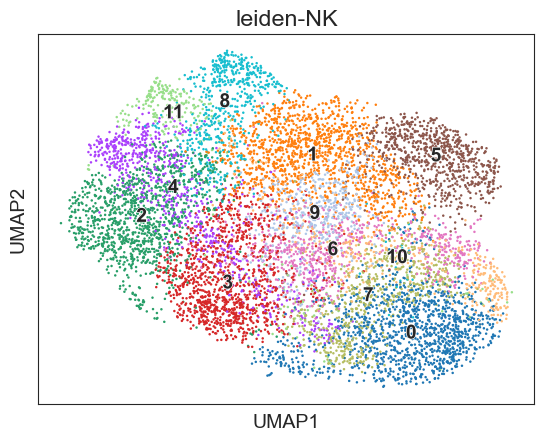

In [ ]:
adata_NK = clu(adata_NK, key_added='leiden-NK', do_har=True, har_key='attr')

In [ ]:
sc.tl.leiden(adata_NK, key_added='leiden-NK0.5', resolution=0.5)
sc.tl.leiden(adata_NK, key_added='leiden-NK0.8', resolution=0.8)
sc.tl.leiden(adata_NK, key_added='leiden-NK0.7', resolution=0.7)

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


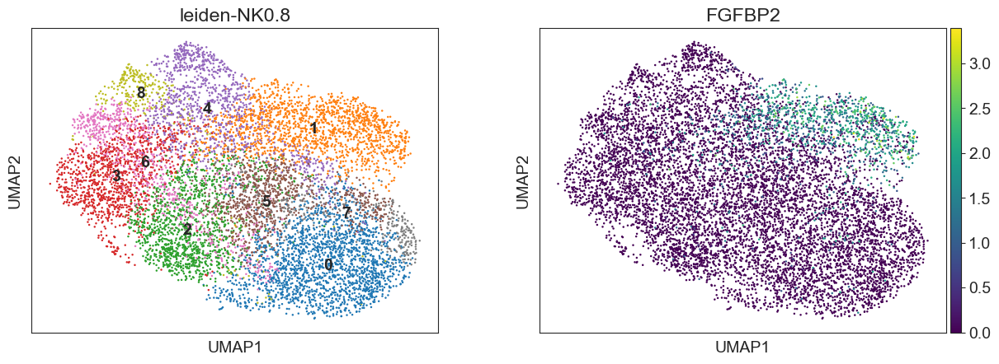

In [ ]:
sc.pl.umap(adata_NK, color=['leiden-NK0.8','FGFBP2'], legend_loc='on data',cmap='viridis')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


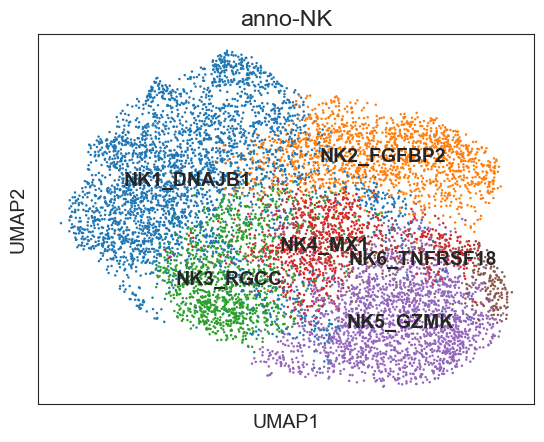

In [ ]:
annot = {
  "NK1_DNAJB1": ['3', '4', '6', '8'],
  'NK2_FGFBP2': ['1'],
  'NK3_RGCC': ['2'],
  'NK4_MX1': ['5'],
  'NK5_GZMK': ['0'],
  'NK6_TNFRSF18':['7'],
}
adata_NK = anno(adata_NK, annot, 'anno-NK', 'leiden-NK0.8')
sc.pl.umap(adata_NK, color=['anno-NK'], legend_loc='on data')

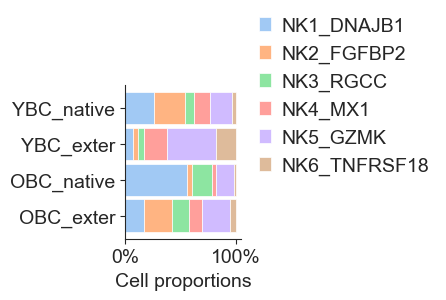

In [ ]:
barlabels = list(adata_NK.obs['attr'].unique())
barlabels.sort()
cell_types = list(adata_NK.obs['anno-NK'].unique())
cell_types.sort()
colors = sns.color_palette("pastel", 6)
# colors = ['#66c2a5', '#fc8d62', '#8da0cb', '#e78ac3', '#a6d854', '#ffd92f', '#e5c494', '#b3b3b3']
age_df = pd.DataFrame(columns = list(cell_types))
for bar in barlabels:
    d1 = pd.DataFrame([((adata_NK.obs["anno-NK"] == ct) & (adata_NK.obs["attr"] == bar)).sum() for ct in list(cell_types)], index = list(cell_types), columns=[bar]).T
    age_df = pd.concat([age_df, d1])
fig0, ax0 = plt.subplots(figsize=(1.5, 2))
propPlot(age_df, ax=ax0, barlabels=barlabels, xlabel='', colors=colors)
fig0.savefig(f"{figPath}/NK_attr_proportions.svg",bbox_inches='tight')

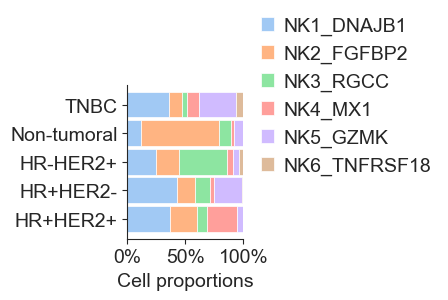

In [ ]:
barlabels = list(adata_NK.obs['IHC'].unique())
barlabels.sort()
cell_types = list(adata_NK.obs['anno-NK'].unique())
cell_types.sort()
colors = sns.color_palette("pastel", 6)
# colors = ['#66c2a5', '#fc8d62', '#8da0cb', '#e78ac3', '#a6d854', '#ffd92f', '#e5c494', '#b3b3b3']
age_df = pd.DataFrame(columns = list(cell_types))
for bar in barlabels:
    d1 = pd.DataFrame([((adata_NK.obs["anno-NK"] == ct) & (adata_NK.obs["IHC"] == bar)).sum() for ct in list(cell_types)], index = list(cell_types), columns=[bar]).T
    age_df = pd.concat([age_df, d1])
fig0, ax0 = plt.subplots(figsize=(1.5, 2))
propPlot(age_df, ax=ax0, barlabels=barlabels, xlabel='', colors=colors)
fig0.savefig(f"{figPath}/NK_IHC-anno-NK_proportions.svg",bbox_inches='tight')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


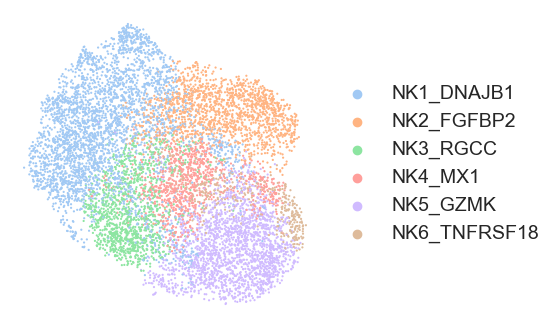

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
palette = sns.color_palette("pastel", 6)
sc.pl.umap(adata_NK, color=['anno-NK'],palette=palette, size=10,title='', ax=ax, show=False)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xlabel("")
ax.set_ylabel("")
fig.savefig(f'{figPath}/anno_NK.png', dpi=400, bbox_inches='tight')

/tmp/ipykernel_4178142/1959444064.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[gene] = np.array(adata[:,gene].X.todense()).flatten()
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/tmp/ipykernel_4178142/1959444064.py:23: UserWarning: FixedFormatter should only be used toge

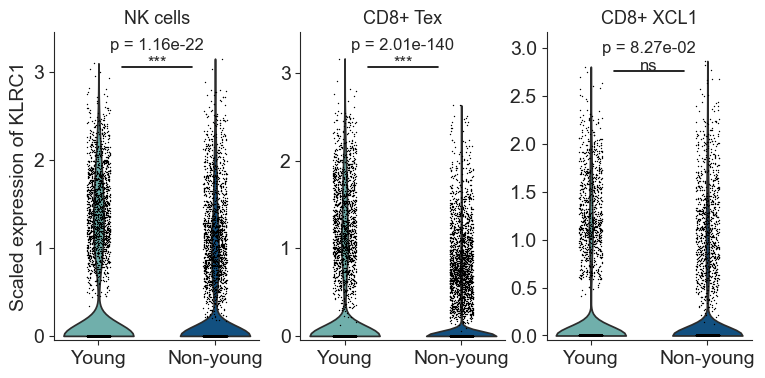

In [610]:
def Gexplot_adata(adata, gene, ax, group='batch'):
  sns.set_style("ticks")
  if gene in adata.obs.columns:
    data = adata.obs[[gene, group]]
  elif gene in adata.var_names:
    data = adata.obs[[group]]
    data[gene] = np.array(adata[:,gene].X.todense()).flatten()
  else:
    raise ValueError(f"{gene} not found in .obs or .var_names.")
  sc.pl.violin(adata, keys=[gene], groupby=group, width=.6,
                  palette=['#66b9b4', '#005292'], ax=ax, show=False)
  t_stat, pval = stats.ttest_ind(data.loc[data[group] == '0', gene],
                                data.loc[data[group] == '1', gene], equal_var=False, )
  if pval < 0.001:
    star = '***'
  elif pval < 0.01:
    star = '**'
  elif pval < 0.05:
    star = '*'
  else:
    star = 'ns'
  ax.set_ylim(min(data[gene])-0.05, max(data[gene]+0.3))
  ax.set_xticklabels(['Young', 'Non-young'])
  sns.lineplot(x=[0.2, 0.8], y=max(data[gene])-0.1, color='black', linewidth=1.2, ax=ax)
  ax.text(0.5, max(data[gene])-0.1, f"p = {pval:.2e}\n{star}", fontsize=12, horizontalalignment='center')
  ax.spines['top'].set_visible(False)
  ax.spines['right'].set_visible(False)
  return ax

fig, ax = plt.subplots(1, 3, figsize=(9,4))
Gexplot_adata(adata_NK, 'KLRC1', ax[0], group='age')
ax[0].set_xlabel('')
ax[0].set_ylabel('Scaled expression of KLRC1')
ax[0].set_title('NK cells', fontsize=13)
Gexplot_adata(adata_Tex, 'KLRC1', ax[1], group='age')
ax[1].set_xlabel('')
ax[1].set_ylabel('')
ax[1].set_title('CD8+ Tex', fontsize=13)
Gexplot_adata(adata_XCL1, 'KLRC1', ax[2], group='age')
ax[2].set_xlabel('')
ax[2].set_ylabel('')
ax[2].set_title('CD8+ XCL1', fontsize=13)
fig.savefig(f"{figPath}/5J-KLRC1.svg", bbox_inches='tight')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


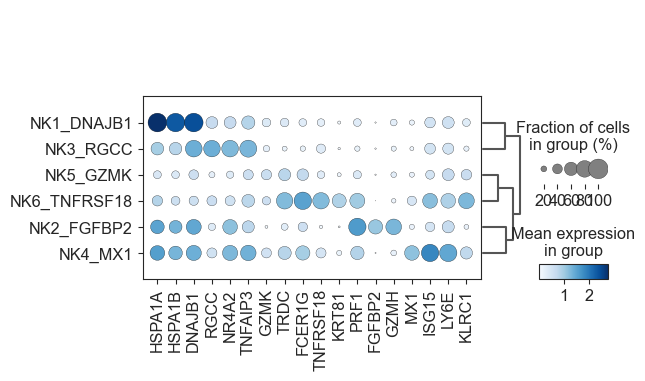

In [574]:
sc.tl.rank_genes_groups(adata_NK, groupby='anno-NK')
sc.tl.dendrogram(adata_NK, groupby='anno-NK')
fig, ax = plt.subplots(1, 1, figsize=(6, 3.5))
sc.pl.rank_genes_groups_dotplot(adata_NK, cmap='Blues', 
                                var_names=['HSPA1A', 'HSPA1B', 'DNAJB1', 
                                           'RGCC', 'NR4A2', 'TNFAIP3',
                                           'GZMK', 'TRDC',
                                           'FCER1G', 'TNFRSF18','KRT81',
                                           'PRF1','FGFBP2', 'GZMH',
                                           'MX1', 'ISG15', 'LY6E', 'KLRC1'], ax=ax)
fig.savefig(f"{figPath}/NK_markers.svg", bbox_inches='tight')

In [ ]:
adata_Tex1 = adata_Tex.copy()
adata_Tex1.obs = adata_Tex1.obs[['batch', 'attr', 'leiden-Tex', 'leiden-Tex1.5', 'leiden-Tex1.6', 'leiden-Tex1.7',
       'leiden-Tex1.8', 'leiden-Tex2.0', 'anno-Tex', 'age', 'IHC','cytotoxicity', 'exhaustion']]
adata_Tex1.write_h5ad("adata-Tex-4.7.h5ad")

/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/anndata.py:1897: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [ ]:
adata_NK1 = adata_NK.copy()
adata_NK1.obs = adata_NK1.obs[['batch','attr', 'leiden-NK', 'inflammation', 'age', 'leiden-NK0.5',
       'leiden-NK0.8', 'leiden-NK0.7', 'anno-NK', 'IHC','cytotoxicity']]
adata_NK1.write_h5ad("adata-NK-4.7.h5ad")

/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/anndata.py:1897: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [ ]:
cytogenes = ['PRF1', 'GZMA', 'GZMB', 'GNLY', 'NKG7', 'GZMK', 'IFNG', 'TNFAIP3', 'IL2RA', 'GZMH', 'ITGAL', 'ITGB2']
infgenes = ["CCL2", "CCL3", "CCL4", "CCL5", "CXCL10", "CXCL9", "IL1B", "IL6", "IL7", "IL15", "IL18"]

sc.tl.score_genes(adata_NK, gene_list=cytogenes, score_name='cytotoxicity')
sc.tl.score_genes(adata_NK, gene_list=infgenes, score_name='inflammation')

In [ ]:
cytogenes = ['PRF1', 'GZMA', 'GZMB', 'GNLY', 'NKG7', 'GZMK', 'IFNG', 'TNFAIP3', 'IL2RA', 'GZMH', 'ITGAL', 'ITGB2']
exgenes = ['PDCD1', 'HAVCR2', 'TIGIT', 'CTLA4', 'LAG3', 'CXCL13', 'ENTPD1']
infgenes = ["CCL2", "CCL3", "CCL4", "CCL5", "CXCL10", "CXCL9", "IL1B", "IL6", "IL7", "IL15", "IL18"]
sc.tl.score_genes(adata_CD8, gene_list=infgenes, score_name='inflammation')
sc.tl.score_genes(adata_CD8, gene_list=exgenes, score_name='exhaustion')
sc.tl.score_genes(adata_CD8, gene_list=cytogenes, score_name='cytotoxicity')

In [ ]:
cytogenes = ['PRF1', 'GZMA', 'GZMB', 'GNLY', 'NKG7', 'GZMK', 'IFNG', 'TNFAIP3', 'IL2RA', 'GZMH', 'ITGAL', 'ITGB2']
exgenes = ['PDCD1', 'HAVCR2', 'TIGIT', 'CTLA4', 'LAG3', 'CXCL13', 'ENTPD1']
sc.tl.score_genes(adata_Tex, gene_list=exgenes, score_name='exhaustion')
sc.tl.score_genes(adata_Tex, gene_list=cytogenes, score_name='cytotoxicity')

In [590]:
import scipy.stats as stats
def DEplot(data, gene, group='batch'):
  ax = sns.violinplot(x=group, y=gene, data=data)
  t_stat, pval = stats.ttest_ind(data[data.batch == '0'][gene],
                                data[data.batch == '1'][gene], equal_var=False, )
  if pval < 0.001:
    star = '***'
  elif pval < 0.01:
    star = '**'
  elif pval < 0.05:
    star = '*'
  else:
    star = 'ns'
  ax.set_xticklabels(['Young', 'Non-young'])
  ax.text(0, max(data[gene]), f"p = {pval:.3f}\n{star}", fontsize=12, horizontalalignment='center')

def DEplot_adata(adata, gene, ax, group='batch'):
  sns.set_style("ticks")
  if gene in adata.obs.columns:
    data = adata.obs[[gene, group]]
  elif gene in adata.var_names:
    data = adata.obs[[group]]
    data[gene] = np.array(adata[:,gene].X.todense()).flatten()
  else:
    raise ValueError(f"{gene} not found in .obs or .var_names.")
  print(data)
  sns.violinplot(data=data, x=group, y=gene,  width=.6,
                  palette=['#66b9b4', '#005292'], ax=ax) # fliersize=0,saturation=0.4,
  sample_data = data.sample(n=1000, random_state=42)
  sns.stripplot(data=sample_data, x=group, y=gene, 
                color='.5', size=3, ax=ax, marker='o', alpha=.5)
  t_stat, pval = stats.ttest_ind(data.loc[data[group] == '0', gene],
                                data.loc[data[group] == '1', gene], equal_var=False, )
  if pval < 0.001:
    star = '***'
  elif pval < 0.01:
    star = '**'
  elif pval < 0.05:
    star = '*'
  else:
    star = 'ns'
  ax.set_ylim(min(data[gene])-0.05, max(data[gene]+0.15))
  ax.set_xticklabels(['Young', 'Non-young'])
  sns.lineplot(x=[0, 1], y=max(data[gene])-0.1, color='black', linewidth=1.2, ax=ax)
  ax.text(0.5, max(data[gene])-0.1, f"p = {pval:.2e}\n{star}", fontsize=12, horizontalalignment='center')
  ax.spines['top'].set_visible(False)
  ax.spines['right'].set_visible(False)
  return ax

In [ ]:
annot = {
  '0': ['YBC_native'],
  '1': ['OBC_native', 'OBC_exter',]
}
adata_CD8 = anno(adata_CD8, annot, 'age', 'attr')

annot = {
  '0': ['YBC_native', 'YBC_exter'],
  '1': ['OBC_native', 'OBC_exter']
}
adata_NK = anno(adata_NK, annot, 'age', 'attr')

annot = {
  '0': ['YBC_native', 'YBC_exter'],
  '1': ['OBC_native', 'OBC_exter']
}
adata_XCL1 = anno(adata_XCL1, annot, 'age', 'attr')

In [ ]:
annot = {
  '0': ['YBC_native', 'YBC_exter'],
  '1': ['OBC_native', 'OBC_exter']
}
adata_Tex = anno(adata_Tex, annot, 'age', 'attr')

In [581]:
np.array(adata_NK[:,'KLRC1'].X.todense()).flatten()

array([1.3685073 , 0.        , 0.        , ..., 0.91744745, 0.        ,
       2.4551597 ], dtype=float32)

/tmp/ipykernel_4178142/3373378860.py:20: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=data, x=group, y=gene, fliersize=0, width=.6,
/tmp/ipykernel_4178142/3373378860.py:36: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['Young', 'Non-young'])
/tmp/ipykernel_4178142/3373378860.py:20: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=data, x=group, y=gene, fliersize=0, width=.6,
/tmp/ipykernel_4178142/3373378860.py:36: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['Young', 'Non-young'])


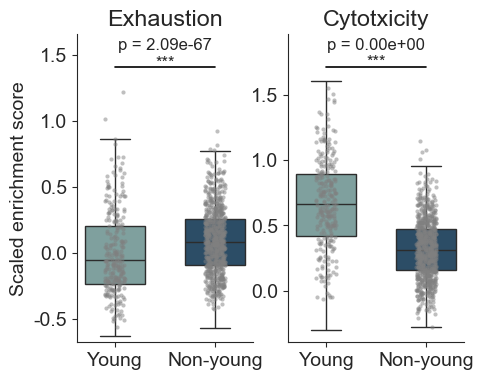

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(5, 4))
ax[0] = DEplot_adata(adata_Tex, gene='exhaustion', ax=ax[0], group='age')
ax[0].set_title('Exhaustion')
ax[0].set_xlabel('')
ax[0].set_ylabel('Scaled enrichment score')
ax[1] = DEplot_adata(adata_Tex, gene='cytotoxicity', ax=ax[1], group='age')
ax[1].set_ylabel('')
ax[1].set_xlabel('')
ax[1].set_title('Cytotxicity')
fig.savefig("figure-1.23/S5e-exhaustion-Tex.svg",bbox_inches='tight')

/tmp/ipykernel_4178142/3373378860.py:20: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=data, x=group, y=gene, fliersize=0, width=.6,
/tmp/ipykernel_4178142/3373378860.py:36: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['Young', 'Non-young'])
/tmp/ipykernel_4178142/3373378860.py:20: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=data, x=group, y=gene, fliersize=0, width=.6,
/tmp/ipykernel_4178142/3373378860.py:36: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['Young', 'Non-young'])


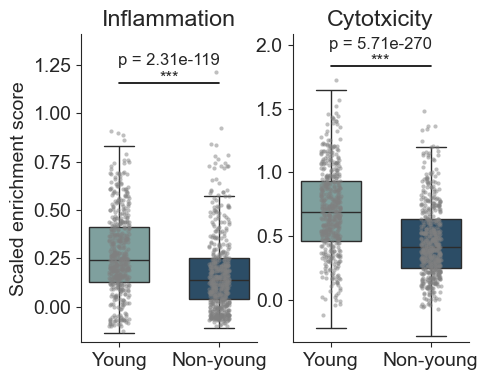

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(5, 4))
ax[0] = DEplot_adata(adata_NK, gene='inflammation', ax=ax[0], group='age')
ax[0].set_title('Inflammation')
ax[0].set_xlabel('')
ax[0].set_ylabel('Scaled enrichment score')
ax[1] = DEplot_adata(adata_NK, gene='cytotoxicity', ax=ax[1], group='age')
ax[1].set_ylabel('')
ax[1].set_xlabel('')
ax[1].set_title('Cytotxicity')
fig.savefig("figure-1.23/S5e-Inflammation-NK.svg",bbox_inches='tight')

/tmp/ipykernel_4178142/2646535281.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[gene] = np.array(adata[:,gene].X.todense()).flatten()
/tmp/ipykernel_4178142/2646535281.py:27: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(data=data, x=group, y=gene,  width=.6,
/tmp/ipykernel_4178142/2646535281.py:43: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['Young', 'Non-young'])
/tmp/ipykernel_4178142/2646535281.py:27: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable

                                             age     KLRC1
AACAAAGGTCAAACGG-1T-YBC_native                 0  1.368507
AACCAACAGGCGCTCT-1T-YBC_native                 0  0.000000
AACCAACAGGGTTAAT-1T-YBC_native                 0  0.000000
AACCATGCAGTGGGTA-1T-YBC_native                 0  0.000000
AAGCCATTCGAACGCC-1T-YBC_native                 0  0.942976
...                                           ..       ...
CID4515_CTCGGGAGTCAATGTC-CID4515-OBC_exter     1  1.819401
CID3963_TCATTTGAGTGGTAGC-CID3963-OBC_exter     1  2.109903
CID3838_GCCCGAAAGTTGTACC-CID3838-OBC_exter     1  0.917447
CID4290A_ACTGTCCTCATCGGAT-CID4290A-OBC_exter   1  0.000000
CID4523_CTGGTCTGTTGGAGGT-CID4523-OBC_exter     1  2.455160

[9391 rows x 2 columns]
                                              cytotoxicity age
AACAAAGGTCAAACGG-1T-YBC_native                    0.356740   0
AACCAACAGGCGCTCT-1T-YBC_native                    0.181177   0
AACCAACAGGGTTAAT-1T-YBC_native                    0.196966   0
AACCATGCAGTGGGT

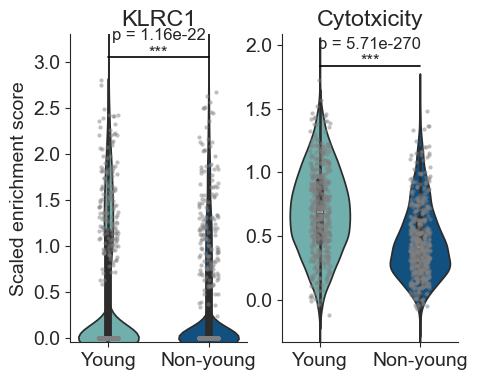

In [591]:
fig, ax = plt.subplots(1, 2, figsize=(5, 4))
ax[0] = DEplot_adata(adata_NK, gene='KLRC1', ax=ax[0], group='age')
ax[0].set_title('KLRC1')
ax[0].set_xlabel('')
ax[0].set_ylabel('Scaled enrichment score')
ax[1] = DEplot_adata(adata_NK, gene='cytotoxicity', ax=ax[1], group='age')
ax[1].set_ylabel('')
ax[1].set_xlabel('')
ax[1].set_title('Cytotxicity')
fig.savefig("figure-1.23/S5e-KLRC1-NK.svg",bbox_inches='tight')

/tmp/ipykernel_4178142/3373378860.py:20: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=data, x=group, y=gene, fliersize=0, width=.6,
/tmp/ipykernel_4178142/3373378860.py:36: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['Young', 'Non-young'])
/tmp/ipykernel_4178142/3373378860.py:20: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=data, x=group, y=gene, fliersize=0, width=.6,
/tmp/ipykernel_4178142/3373378860.py:36: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['Young', 'Non-young'])


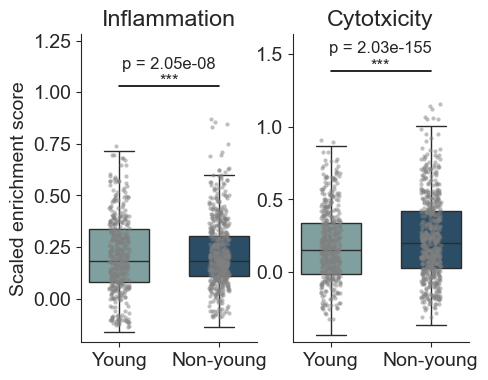

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(5, 4))
ax[0] = DEplot_adata(adata_CD8, gene='inflammation', ax=ax[0], group='age')
ax[0].set_title('Inflammation')
ax[0].set_xlabel('')
ax[0].set_ylabel('Scaled enrichment score')
ax[1] = DEplot_adata(adata_CD8, gene='cytotoxicity', ax=ax[1], group='age')
ax[1].set_ylabel('')
ax[1].set_xlabel('')
ax[1].set_title('Cytotxicity')
fig.savefig("figure-1.23/S5e-Exhaustion-CD8.svg",bbox_inches='tight')

In [ ]:
de_attrNK = DE_memento_1d(adata_NK, ctleft=['YBC_native', 'YBC_exter'], ctright=['OBC_native','OBC_exter'], groupby='attr')

/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/anndata.py:1897: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/home/rzh/BCY/lib/python3.10/site-packages/anndata/_core/anndata.py:1897: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
/home/rzh/BCY/lib/python3.10/site-packages/setuptools_scm/_integration/setuptools.py:30: RuntimeWarning: 
ERROR: setuptools==59.6.0 is used in combination with setuptools_scm>=8.x

Your build configuration is incomplete and previously worked by accident!
setuptools_scm requires setuptools>=61

Suggested workaround if applicable:
 - migrating from the deprecated setup_requires mechanism to pep517/518
   and using a pyproject.toml to declare build dependencies
   which are reliably pre-installed befo

In [ ]:
de_attrNK.sort_values(by='de_coef')

,gene,tx,de_coef,de_se,de_pval,dv_coef,dv_se,dv_pval
19,IGKC,stim,-1.359052,0.061086,2.520666e-109,1.018458,0.243815,2.066077e-05
88,MX1,stim,-1.322144,0.049364,1.382891e-157,-0.453745,0.640915,6.858376e-01
13,IFI44L,stim,-0.986183,0.051275,3.342775e-82,0.414477,0.259304,8.642830e-02
60,PRF1,stim,-0.965749,0.031409,4.912551e-207,3.594062,1.031468,3.814328e-04
51,CEBPD,stim,-0.849894,0.047518,1.718069e-71,0.441048,0.267120,7.672739e-02
...,...,...,...,...,...,...,...,...
15,LMNA,stim,0.684250,0.039920,5.741831e-66,-0.473892,0.207957,2.539368e-02
80,MT1X,stim,0.735438,0.059976,1.478174e-34,2.806049,0.171286,1.131844e-59
73,RGCC,stim,0.761824,0.030198,1.117026e-140,-0.454899,0.186967,1.795841e-02
8,ID3,stim,1.000174,0.055720,3.166527e-72,0.463491,0.174359,6.239050e-03


In [ ]:
%%R -i de_attrNK_native
library(ggVolcano)
library(RColorBrewer)
library(ggsci)
data <- add_regulate(de_attrNK_native, log2FC_name = "de_coef",
                     fdr_name = "de_pval",log2FC = 0.4, fdr = 0.05)
# plot
p <- ggvolcano(data, x = "log2FoldChange", y = "padj",
          label = "gene", label_number = 20, 
          output = FALSE, legend_position = "UL",
          log2FC_cut = 0.4, FDR_cut = 0.05) +
    labs(x="correlation", y="-log P-value")
ggsave("~/figure-1.23/DE_NK_attr_native.pdf", p, width = 3, height = 3, units = "in")

In [ ]:
%%R -i de_attrNK
library(ggVolcano)
library(RColorBrewer)
library(ggsci)
data <- add_regulate(de_attrNK, log2FC_name = "de_coef",
                     fdr_name = "de_pval",log2FC = 0.4, fdr = 0.05)
# plot
p <- ggvolcano(data, x = "log2FoldChange", y = "padj",
          label = "gene", label_number = 20, 
          output = FALSE, legend_position = "UL",
          log2FC_cut = 0.4, FDR_cut = 0.05) +
    labs(x="correlation", y="-log P-value")
ggsave("~/figure-1.23/DE_NK_attr.pdf", p, width = 3, height = 3, units = "in")

In [ ]:
de_attrNK.loc[de_attrNK['gene'] == 'KLRC1', :]

,gene,tx,de_coef,de_se,de_pval,dv_coef,dv_se,dv_pval


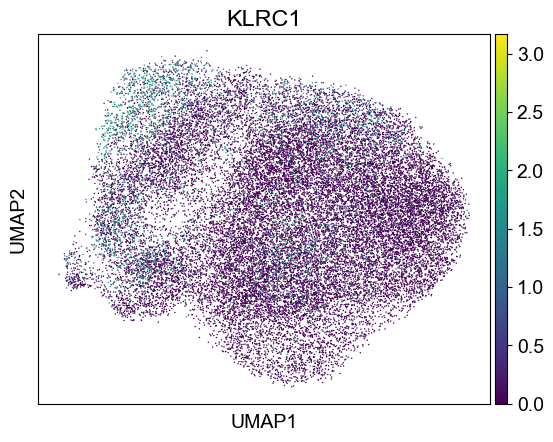

In [ ]:
sc.pl.umap(adata_YBC_native_CD8, color=['KLRC1'], use_raw=False)

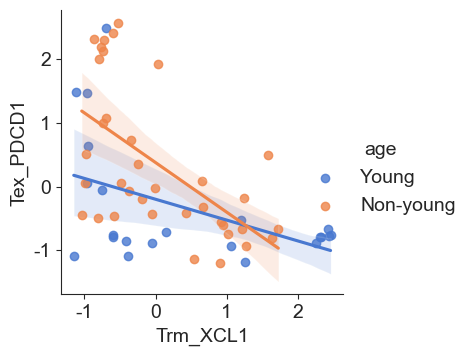

In [ ]:
# spinplot lines
from sklearn.preprocessing import StandardScaler, MinMaxScaler
def get_agedf(adata, barname, cellname, texlist, age):
  barlabels = adata.obs[barname].cat.categories
  cell_types = adata.obs[cellname].cat.categories
  age_df = pd.DataFrame(columns = list(cell_types))
  for bar in barlabels:
      d1 = pd.DataFrame([len(adata[(adata.obs[cellname] == ct) & (adata.obs[barname] == bar)]) for ct in list(cell_types)], index = list(cell_types), columns=[bar]).T
      age_df = pd.concat([age_df, d1])
  age_df['Tex_PDCD1'] = 0
  for tl in texlist:
     age_df['Tex_PDCD1'] = age_df['Tex_PDCD1'] + age_df[tl]
     del age_df[tl]
  all_df = age_df.sum(axis=1)
  age_normdf = pd.DataFrame([age_df.loc[i,:]/all_df[i] for i in barlabels], index=barlabels)
  scaler = StandardScaler()
  age_scaledf = scaler.fit_transform(age_normdf.T)
  age_scaledf = pd.DataFrame(age_scaledf.T, columns=age_normdf.columns)
  age_scaledf['age'] = age
  age_scaledf['Trm_XCL1']  = age_scaledf['C01_Trm_XCL1']
  total_df = age_scaledf[['Tex_PDCD1','Trm_XCL1','age']]
  return total_df
YBC_native_df = get_agedf(adata_YBC_native_CD8, 'batch', 'anno-CD8T', ['C08_cTex_ENTPD1', 'C09_tTex_CD200', 'C10_Tprolif_MKI67'], 'Young')
YBC_exter_df = get_agedf(adata_YBC_exter_CD8, 'batch', 'anno-CD8T', [ 'C08_Tex_PDCD1', 'C10_Tprolif_MKI67'], 'Young')
OBC_exter_df = get_agedf(adata_OBC_exter_CD8, 'batch', 'anno-CD8T', [ 'C08_Tex_ENTPD1','C09_Tprolif_MKI67'], 'Non-young')
OBC_native_df = get_agedf(adata_OBC_native_CD8, 'batch', 'anno-CD8T', [ 'C08_pTex_ENTPD1', 'C09_tTex_CD200','C10_Tprolif_MKI67'], 'Non-young')
Tex_XCL1_df = pd.concat([YBC_native_df, YBC_exter_df, OBC_exter_df, OBC_native_df], axis=0)
import seaborn as sns

ax = sns.lmplot(x='Trm_XCL1', y='Tex_PDCD1', hue='age', data=Tex_XCL1_df, logistic=False, palette="muted", order=1)
ax.fig.set_size_inches((5, 3.5))
ax.fig.savefig("figure-1.23/S1d-Tex-XCL1-reg.svg", bbox_inches='tight')

In [653]:
adata_OBC_exter_CD4.write_h5ad('adata-OBC-exter-CD4T-3.24.h5ad')
adata_OBC_exter_CD8.write_h5ad('adata-OBC-exter-CD8T-3.24.h5ad')